# Модель прогнозирования стоимости жилья для агентства недвижимости - Часть 1

**Цель:** разработать модель машинного обучения, которая поможет обрабатывать объявления и увеличит число сделок и прибыль агентства.

In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import re
import ast
import plotly.graph_objects as go
import pickle
import xgboost as xgb

from sklearn.preprocessing import MinMaxScaler, StandardScaler, LabelEncoder, PolynomialFeatures
from sklearn import linear_model
from sklearn import preprocessing
from sklearn import model_selection
from sklearn import tree
from sklearn import ensemble
from sklearn import metrics
from sklearn import feature_selection
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV
from sklearn.linear_model import Lasso
from catboost import CatBoostRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from scipy import stats

import warnings
warnings.filterwarnings('ignore')

%matplotlib inline

In [2]:
# Функция для построения графиков 
def show_plot(col):
    plt.figure(figsize=(12,6))
    col.value_counts().plot(kind='bar')
    for i,val in enumerate(col.value_counts()):
        plt.text(i, val, int(val))
    plt.show()

# Постановка проблемы

Агентство недвижимости столкнулось с проблемой — риелторы тратят слишком много времени на сортировку объявлений и поиск выгодных предложений. Поэтому скорость их реакции и качество анализа не дотягивают до уровня конкурентов. Это сказывается на финансовых показателях агентства.

**Задача**: разработать модель машинного обучения, которая поможет обрабатывать объявления и увеличит число сделок и прибыль агентства.

# Сбор данных

Для работы над проблемой представлен [датасет](https://drive.google.com/file/d/11-ZNNIdcQ7TbT8Y0nsQ3Q0eiYQP__NIW/view?usp=share_link) реальных объявлений о продажи недвижимости в США.

In [3]:
# Считаем данные и отобразим первые 5 строк
data = pd.read_csv('data/data.csv')
data.head(5)

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,PrivatePool,MlsId,target
0,Active,NaN,Single Family Home,240 Heather Ln,3.5,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",Gas Logs,Southern Pines,"[{'rating': ['4', '4', '7', 'NR', '4', '7', 'N...",2900,28387,4,NC,NaN,NaN,NaN,611019,"$418,000"
1,for sale,NaN,single-family home,12911 E Heroy Ave,3 Baths,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",NaN,Spokane Valley,"[{'rating': ['4/10', 'None/10', '4/10'], 'data...","1,947 sqft",99216,3 Beds,WA,2.0,NaN,NaN,201916904,"$310,000"
2,for sale,NaN,single-family home,2005 Westridge Rd,2 Baths,"{'atAGlanceFacts': [{'factValue': '1961', 'fac...",yes,Los Angeles,"[{'rating': ['8/10', '4/10', '8/10'], 'data': ...","3,000 sqft",90049,3 Beds,CA,1.0,NaN,yes,FR19221027,"$2,895,000"
3,for sale,NaN,single-family home,4311 Livingston Ave,8 Baths,"{'atAGlanceFacts': [{'factValue': '2006', 'fac...",yes,Dallas,"[{'rating': ['9/10', '9/10', '10/10', '9/10'],...","6,457 sqft",75205,5 Beds,TX,3.0,NaN,NaN,14191809,"$2,395,000"
4,for sale,NaN,lot/land,1524 Kiscoe St,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Palm Bay,"[{'rating': ['4/10', '5/10', '5/10'], 'data': ...",NaN,32908,NaN,FL,NaN,NaN,NaN,861745,"$5,000"


In [4]:
print(data.shape)
data.info()

(377185, 18)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 377185 entries, 0 to 377184
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   status        337267 non-null  object
 1   private pool  4181 non-null    object
 2   propertyType  342452 non-null  object
 3   street        377183 non-null  object
 4   baths         270847 non-null  object
 5   homeFacts     377185 non-null  object
 6   fireplace     103114 non-null  object
 7   city          377151 non-null  object
 8   schools       377185 non-null  object
 9   sqft          336608 non-null  object
 10  zipcode       377185 non-null  object
 11  beds          285903 non-null  object
 12  state         377185 non-null  object
 13  stories       226469 non-null  object
 14  mls-id        24942 non-null   object
 15  PrivatePool   40311 non-null   object
 16  MlsId         310305 non-null  object
 17  target        374704 non-null  object
dtypes: object(1

In [5]:
from ydata_profiling import ProfileReport
profile = ProfileReport(data, title="ИНФОРМАЦИЯ ОБ ОБЪЕКТАХ НЕДВИЖИМОСТИ")
profile.to_file("raw_data.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

# Очистка данных

Предоставленный для анализа массив данных состоит из 18 колонок/признаков и 377185 строк/объектов. 
Все признаки имеют тип object.

Набор признаков выглядит следующим образом:
- 'status' — статус продажи;
- 'private pool' и 'PrivatePool' — наличие собственного бассейна;
- 'propertyType' — тип объекта недвижимости;
- 'street' — адрес объекта;
- 'baths' — количество ванных комнат;
- 'homeFacts' — сведения о строительстве объекта (содержит несколько типов сведений, влияющих на оценку объекта);
- 'fireplace' — наличие камина;
- 'city' — город;
- 'schools' — сведения о школах в районе;
- 'sqft' — площадь в футах;
- 'zipcode' — почтовый индекс;
- 'beds' — количество спален;
- 'state' — штат;
- 'stories' — количество этажей;
- 'mls-id' и 'MlsId' — идентификатор MLS (Multiple Listing Service, система мультилистинга);
- 'target' — цена объекта недвижимости (целевой признак, который необходимо спрогнозировать).

Проведём поэтапный анализ каждого из признаков.

Что сразу бросилось в глаза:
- признаки 'mls-id' и 'MlsId' содержат огромное количество уникальных значений, скорее всего это уникальные идентификаторы объектов недвижимости зарегистрированные в системе взаимодействия участников рынка недвижимости. Т.е. данные признаки никоим образом не характеризуют сам объект недвижимости и не влияют на целевую переменную, поэтому можно не тратить на них время и сразу удалить.
- признаки 'street', 'city', 'zipcode' и 'state' с той или иной долей точности характеризуют местоположение объекта недвижимости и наверняка между ними будет существовать корреляция, поэтому нужно оценить качество данных в этих признаках и оставить что-то одно, логичнее было бы оставить 'zipcode', т.к. он содержит числовые значения, кроме того ZIP-code, используя 5 знаков, кодирует определенный район города. Например, в Нью-Йорке насчитывается более 300 zipcode. Если сравнивать с Москвой, где стоимость недвижимости оценивают по районам, то город делится на 132 района. Т.е. получается что у Нью-Йорка еще более мелкая детализация за счет использования зип-кодов, уникальных значений которого в наших данных содержится более 4500.\
Признак 'street' содержит более 337 тысяч! уникальных значений. Перелопачивать такой объем на мой взгляд будет пустой тратой времени.\
Признак 'city' представлен двумя тысячами городов. А в признаке 'state' содержится 39 штатов.
В признаке zipcode отсутствуют пропущенные значения, более 99% значений являются цифровыми, средняя и медианная длина значений составляет 5 символов (как и положено для американских индексов), т.е. данные в этом признаке заполнены достаточно качественно.

**Предположение/допущение:** не тратить время на признаки штата, города и улицы, которые содержат текстовые значения, а остановится только на анализе индексов, тем более, как ранее было сказано, для оценки стоимости недвижимости достаточно будет деления на районы городов (по аналогии с Москвой).

### Признак 'zipcode'


Раз уж мы акцентировали внимание на признаке zipcode, то с него и начнем. Тем более, что он характеризует местоположение объекта, а какой бы дом не был, все-таки локация занимает важное место в структуре цены. 

Посмотрим первую сотню кодов:

In [6]:
data['zipcode'].sort_values().unique()[:100]

array(['--', '0', '00000', '02108', '02109', '02110', '02111', '02113',
       '02114', '02115', '02116', '02118', '02119', '02120', '02121',
       '02122', '02124', '02125', '02126', '02127', '02128', '02129',
       '02130', '02131', '02132', '02134', '02135', '02136', '02199',
       '02210', '02215', '02467', '04666', '04901', '04937', '04957',
       '04963', '05345', '05441', '05441-4400', '05443', '05444', '05445',
       '05448', '05450', '05454', '05455', '05456', '05457', '05461',
       '05462', '05464', '05469', '05472', '05473', '05478', '05482',
       '05483', '05487', '05488', '05491', '05642', '07004', '07004-1106',
       '07004-1300', '07004-1413', '07004-1528', '07004-1607',
       '07004-1809', '07004-1878', '07004-1935', '07004-2116',
       '07004-2137', '07004-2214', '08701', '10001', '10002', '10003',
       '10004', '10005', '10006', '10007', '10009', '10010', '10011',
       '10012', '10013', '10014', '10016', '10017', '10018', '10019',
       '10021', '1002

In [7]:
# Посмотрим на непонятные 3 значения:
data[(data['zipcode']=='--') | (data['zipcode']=='0') | (data['zipcode']=='00000')]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,PrivatePool,MlsId,target
30261,Active,NaN,Land,Gates Canyon Rd,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Vacaville,"[{'rating': ['7', '4', '6', '6', '10', '2'], '...",0,0,NaN,CA,NaN,NaN,NaN,21904829,"$380,000"
83522,New,NaN,Colonial,Cornejo Ricardo Descalzi,NaN,"{'atAGlanceFacts': [{'factValue': '1995', 'fac...",NaN,Quito Ecuador,"[{'rating': [], 'data': {'Distance': [], 'Grad...",NaN,0,NaN,NY,NaN,NaN,NaN,3177007,"470,000"
231282,New construction,NaN,NaN,0 N Gopher Canyon Rd,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Bonsall,"[{'rating': ['7/10', '7/10', '3/10'], 'data': ...",NaN,--,449 acres,CA,NaN,OC19261036,NaN,NaN,"$60,000,000"
235207,NaN,NaN,Townhouse,1744 N Dixie Hwy # 1744,3.0,"{'atAGlanceFacts': [{'factValue': '2010', 'fac...",NaN,Fort Lauderdale,"[{'rating': ['3/10', '5/10', '7/10'], 'data': ...","2,043",--,3,FL,NaN,NaN,NaN,"1744, Fort Lauderdale, FL","$425,000"
305572,for sale,NaN,lot/land,000 U.S. Hwy 359,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Laredo,"[{'rating': ['4/10'], 'data': {'Distance': ['7...","243,849 sqft",0,NaN,TX,NaN,NaN,NaN,20193508,"$1,740,000"
308229,Active,NaN,NaN,435 pescador,NaN,"{'atAGlanceFacts': [{'factValue': '1972', 'fac...",NaN,Foreign Country,"[{'rating': [], 'data': {'Distance': [], 'Grad...","1,100",00000,NaN,OS,NaN,NaN,NaN,CV18033361,"125,000"


Таких записей оказалось всего 6 штук, поэтому можно смело удалить их, тем более что они содержат пропущенные значения и в других признаках.

In [8]:
data = data.drop(data[(data['zipcode']=='--') | (data['zipcode']=='0') | (data['zipcode']=='00000')].index)

Также мы видим, что в значениях встречаются 9ти значные зипкоды, разделенные чертой. Как правило такие коды использются для еще большей детализации района, вплоть до улицы, либо какими-то крупными организациями, получающими много писем. Проверим количество таких кодов:

In [9]:
data[data['zipcode'].str.contains('.*-.*',na=False, regex=True)].shape

(240, 18)

Таких кодов всего 240, поэтому предлагается сократить их до 5 знаков:

In [10]:
data['zipcode'] = data['zipcode'].str.replace("-.+",'', regex=True)

In [11]:
# Сделаем доп.поле, в котором переведем зип-коды в числовой формат
data['ZIP'] = data['zipcode'].apply(lambda x: int(x))

!!! Зип-коды это цифры, причем они могут быть выстроены иерархически (по возрастанию). Такой признак будет некорректно использовать в модели машинного обучения. В интернет были найдены 2 ресурса в которых есть соответствие зип-кодов с географическими координатами (широта и долгота):
- https://www.kaggle.com/datasets/joeleichter/us-zip-codes-with-lat-and-long
- https://redivis.com/datasets/d5sz-fq0mbm2ty/tables

В обоих выгрузках присутствовали коды, которые отсутствовали в другой выгрузке, поэтому пришлось объединить их вручную.\
Подтянем эти данные в нашу модель:

In [12]:
zip_geo = pd.read_excel('data/zip_geo.xls')
zip_geo.tail()

,ZIP,LAT,LNG
43415,99926,55.138352,-131.470424
43416,99927,56.239062,-133.457924
43417,99928,55.395359,-131.675370
43418,99929,56.370751,-131.693301
43419,99950,55.875767,-131.466330


In [13]:
data_geo = data.merge(
    zip_geo,
    on='ZIP',
    how='left'
)
display(data_geo.head())

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,beds,state,stories,mls-id,PrivatePool,MlsId,target,ZIP,LAT,LNG
0,Active,NaN,Single Family Home,240 Heather Ln,3.5,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",Gas Logs,Southern Pines,"[{'rating': ['4', '4', '7', 'NR', '4', '7', 'N...",2900,...,4,NC,NaN,NaN,NaN,611019,"$418,000",28387,35.179251,-79.376489
1,for sale,NaN,single-family home,12911 E Heroy Ave,3 Baths,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",NaN,Spokane Valley,"[{'rating': ['4/10', 'None/10', '4/10'], 'data...","1,947 sqft",...,3 Beds,WA,2.0,NaN,NaN,201916904,"$310,000",99216,47.686363,-117.216681
2,for sale,NaN,single-family home,2005 Westridge Rd,2 Baths,"{'atAGlanceFacts': [{'factValue': '1961', 'fac...",yes,Los Angeles,"[{'rating': ['8/10', '4/10', '8/10'], 'data': ...","3,000 sqft",...,3 Beds,CA,1.0,NaN,yes,FR19221027,"$2,895,000",90049,34.092540,-118.491064
3,for sale,NaN,single-family home,4311 Livingston Ave,8 Baths,"{'atAGlanceFacts': [{'factValue': '2006', 'fac...",yes,Dallas,"[{'rating': ['9/10', '9/10', '10/10', '9/10'],...","6,457 sqft",...,5 Beds,TX,3.0,NaN,NaN,14191809,"$2,395,000",75205,32.835893,-96.795514
4,for sale,NaN,lot/land,1524 Kiscoe St,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Palm Bay,"[{'rating': ['4/10', '5/10', '5/10'], 'data': ...",NaN,...,NaN,FL,NaN,NaN,NaN,861745,"$5,000",32908,27.956344,-80.698949


Проверим сколько пустых значений у нас в новых столбцах:

In [14]:
data_geo['LAT'].isna().sum()

218

In [15]:
# проверим для каких зипкодов отсутствуют географические координаты
data_geo[data_geo['LNG'].isnull()]['ZIP'].unique()

array([ 84129,  75072,  97703,  93737,  75033,  90109,   3316,  75036,
        98489, 123456,   5642,  33249,  78697, 112229, 331446,  22703,
        33000,  89105,  27000,  44037,  38818,   5940,  98798],
      dtype=int64)

Отдельной проверкой было установлено, что наибольшее кол-во пропущенных географических координат относится к зипкоду 75072.\
Этот код указывается для города McKinney, для которого наиболее часто встречающимся кодом является 75071. Поэтому предлагается заменить код 75072 на 75071, а также заполнить соответствующие пустые значения координат.

In [16]:
data_geo[data_geo['ZIP'] == 75072]['city'].value_counts()

city
McKinney    86
Mckinney     3
Name: count, dtype: int64

In [17]:
data_geo[data_geo['city'] == 'McKinney']['ZIP'].value_counts()

ZIP
75071    460
75070    316
75072     86
75069     70
Name: count, dtype: int64

In [18]:
data_geo.loc[data_geo['ZIP'] == 75072, 'LAT'] = data_geo[data_geo['ZIP'] == 75071]['LAT'].mode()[0]
data_geo.loc[data_geo['ZIP'] == 75072, 'LNG'] = data_geo[data_geo['ZIP'] == 75071]['LNG'].mode()[0]
data_geo.loc[data_geo['ZIP'] == 75072, 'ZIP'] = 75071

In [19]:
# проверим каких еще много пустых значений осталось, для каких городов
print("Всего пустых значений: ", data_geo['LAT'].isna().sum())
data_geo[data_geo['LAT'].isna()]['city'].value_counts().nlargest(3)

Всего пустых значений:  129


city
Frisco    40
Bend      25
Fresno    23
Name: count, dtype: int64

In [20]:
# заполним пустые значения географических координат для городов Frisco, Bend и Fresno модальными значениями координат для этих городов
no_zip_city = ['Frisco', 'Bend', 'Fresno']
for i in no_zip_city:
    data_geo.loc[data_geo['city'] == i, 'LAT'] = data_geo[data_geo['city'] == i]['LAT'].mode()[0]
    data_geo.loc[data_geo['city'] == i, 'LNG'] = data_geo[data_geo['city'] == i]['LNG'].mode()[0]

In [21]:
# проверим каких еще много пустых значений осталось, для каких городов
print("Всего пустых значений LAT: ", data_geo['LAT'].isna().sum())
print("Всего пустых значений LNG: ", data_geo['LNG'].isna().sum())

Всего пустых значений LAT:  41
Всего пустых значений LNG:  41


Предлагается заверишть на этом обработку и удалить оставшиеся строки с пустыми значениями в признаках географических координат, таких строк всего 41 штука:

In [22]:
data = data_geo.dropna(subset=['LAT'])

Отобразим на карте страны наши объекты недвижимости:

https://datascience.quantecon.org/tools/maps.html

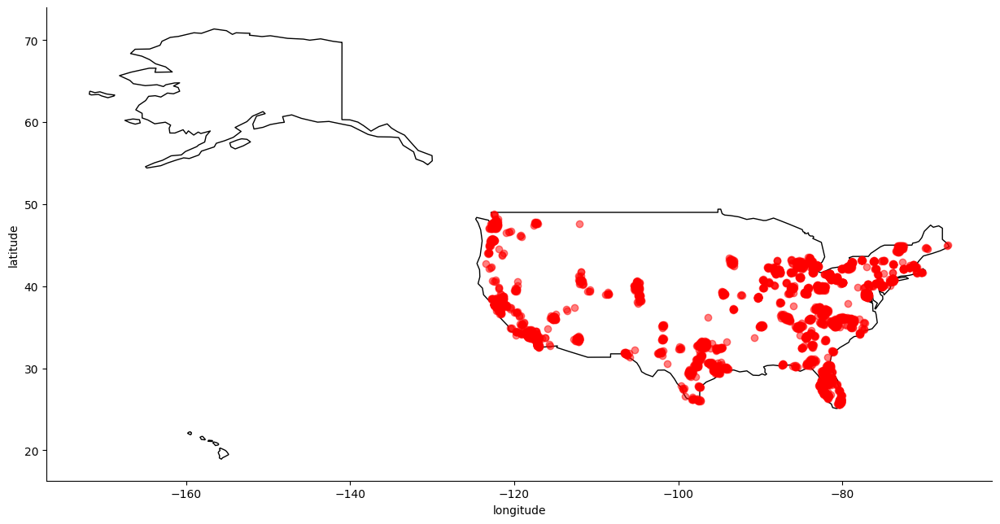

In [23]:
from shapely.geometry import Point

%matplotlib inline

df = pd.DataFrame()
df["Coordinates"] = list(zip(data_geo.LNG, data_geo.LAT))
df = df.drop_duplicates()
df["Coordinates"] = df["Coordinates"].apply(Point)
gdf = gpd.GeoDataFrame(df, geometry="Coordinates")

url = "https://naciscdn.org/naturalearth/110m/cultural/ne_110m_admin_0_countries.zip"

world = gpd.read_file(url)[['SOV_A3', 'NAME', 'geometry']]
world = world.set_index("SOV_A3")

fig, gax = plt.subplots(figsize=(15,15))

world.query("NAME == 'United States of America'").plot(ax=gax, edgecolor='black',color='white')

gdf.plot(ax=gax, color='red', alpha = 0.5)

gax.set_xlabel('longitude')
gax.set_ylabel('latitude')

gax.spines['top'].set_visible(False)
gax.spines['right'].set_visible(False)

plt.show()

### Признак 'status'

In [24]:
data['status'].value_counts()

status
for sale                156077
Active                  105194
For sale                 43465
foreclosure               6426
New construction          5474
                         ...  
Contingent   No Show         1
Coming soon: Oct 24.         1
Coming soon: Oct 21.         1
Coming soon: Nov 14.         1
Coming soon: Dec 23.         1
Name: count, Length: 159, dtype: int64

Признак **status** содержит 159 уникальных значений и 39914 пропусков (10,6% от всего количества). Пропусков достаточно много чтобы просто удалить их.\
Некоторые значения имеют разнообразное написание, но одинаковый смысл (причем можно ввстретить написание как в нижнем регистре, так и в верхнем). Необходимо унифицировать значения признака, как минимум приведя их к нижнему регистру.\
Также пока заменим пустые значения словом "none".

In [25]:
data['status'] = data['status'].fillna('none')
data['status'] = data['status'].apply(lambda x: x.lower())
# Проверим какие наиболее часто используемые слова
data['status'].value_counts()

status
for sale                199544
active                  105194
none                     39914
foreclosure               6769
new construction          5474
                         ...  
coming soon: dec 25.         1
coming soon: oct 24.         1
pending take backups         1
contract                     1
coming soon: dec 23.         1
Name: count, Length: 153, dtype: int64

In [26]:
# Посмотрим на весь перечень возможных значений признака
data['status'].value_counts().index.tolist()

['for sale',
 'active',
 'none',
 'foreclosure',
 'new construction',
 'pending',
 'pre-foreclosure',
 'pre-foreclosure / auction',
 'p',
 'under contract show',
 ' / auction',
 'under contract   showing',
 'active under contract',
 'under contract',
 'new',
 'contingent',
 'price change',
 'auction',
 'foreclosed',
 'a active',
 'for rent',
 'recently sold',
 'under contract backups',
 'contingent finance and inspection',
 'pending continue to show',
 'back on market',
 'option pending',
 'contingent show',
 'pending taking backups',
 'option contract',
 'active with offer',
 'pending with contingencies',
 'active backup',
 'c',
 'pi',
 'contract p',
 'p pending sale',
 'auction - active',
 'listing extended',
 'due diligence period',
 'contract contingent on buyer sale',
 'c continue show',
 'closed',
 'pending - taking backups',
 'active/contingent',
 'offer pending signature',
 'pending inspection',
 'contingent take backup',
 'pending in',
 'contingent   show',
 'active with conti

Видим, что достаточно много встречается значений, начинающихся со слов "сoming soon...". Заменим их просто на "сoming soon"

In [27]:
data['status'] = data['status'].apply(lambda x: 'coming soon' if x.startswith('coming soon:') else  x)
# Проверим какие наиболее часто используемые слова остались
data['status'].value_counts(normalize=True)

status
for sale                  0.529101
active                    0.278927
none                      0.105834
foreclosure               0.017948
new construction          0.014515
                            ...   
contract                  0.000003
contingent   no show      0.000003
conditional contract      0.000003
pending backups wanted    0.000003
backup                    0.000003
Name: proportion, Length: 112, dtype: float64

Объединим: 
- 'foreclosed' и 'foreclosure'
- 'pre-foreclosure' и 'pre-foreclosure / auction' и 'pf'
........

а также прочие часто встречающиеся, ошибочно записанные или означающие одно и то же. А также уберем лишние пробелы.

In [28]:
def status_change(x):
    x = x.replace('pre-foreclosure / auction', 'pre-foreclosure')
    x = x.replace('pf', 'pre-foreclosure')
    x = x.replace('pre-foreclosedauction', 'pre-foreclosure')
    
    x = x.replace('foreclosure', 'foreclosed')
    x = x.replace('contingent foreclosure', 'foreclosed')
    
    x = x.replace('under contract show', 'under contract showing')
    x = x.replace('active under contract', 'under contract showing')
    x = x.replace('u under contract', 'under contract showing')
    x = x.replace('under contract - show', 'under contract showing')
    x = x.replace('under contract - no show', 'under contract showing')

    x = x.replace('active backup', 'under contract backups')
    x = x.replace('backup contract', 'under contract backups')
    x = x.replace('under contract w/ bckp', 'under contract backups')
    x = x.replace('under contract taking back up offers', 'under contract backups')    
    
    x = x.replace('a active', 'active') 
    
    x = x.replace(' / auction', 'auction') 
    x = x.replace('auction - active', 'auction') 
    x = x.replace('active - auction', 'auction') 
    
    x = x.replace('     ', ' ')
    x = x.replace('    ', ' ')
    x = x.replace('   ', ' ')
    x = x.replace('  ', ' ')
    return x.strip()
    
data['status'] = data['status'].apply(status_change)
    

In [29]:
data['status'].value_counts()

status
for sale                     199544
active                       105637
none                          39914
foreclosed                     7228
new construction               5474
                              ...  
contract                          1
temporary active                  1
pending, continue to show         1
pending bring backup              1
backup                            1
Name: count, Length: 94, dtype: int64

Ранее мы заменили пропущенные значения словом none. Предлагается заменить его на самое популярное значение - for sale, это же все-таки база объектов недвижимости на продажу

In [30]:
data['status'] = data['status'].apply(lambda x: x.replace('none', 'for sale'))

In [31]:
data['status'].value_counts(normalize=True).nlargest(10)

status
for sale                  0.634935
active                    0.280102
foreclosed                0.019165
new construction          0.014515
pending                   0.012746
pre-foreclosed            0.009766
under contract showing    0.007199
auction                   0.004004
p                         0.003946
under contract            0.001832
Name: proportion, dtype: float64

Статусы недвижимости имеют 93 разновидности. Однако на первые ТОП-8 категорий приходится более 98% от всех записей. Поэтому предлагается остальные отнести к категории 'other'

In [32]:
top_status = data['status'].value_counts()[:8].index
data['status'] = data['status'].apply(lambda x: x if x in top_status else 'other')

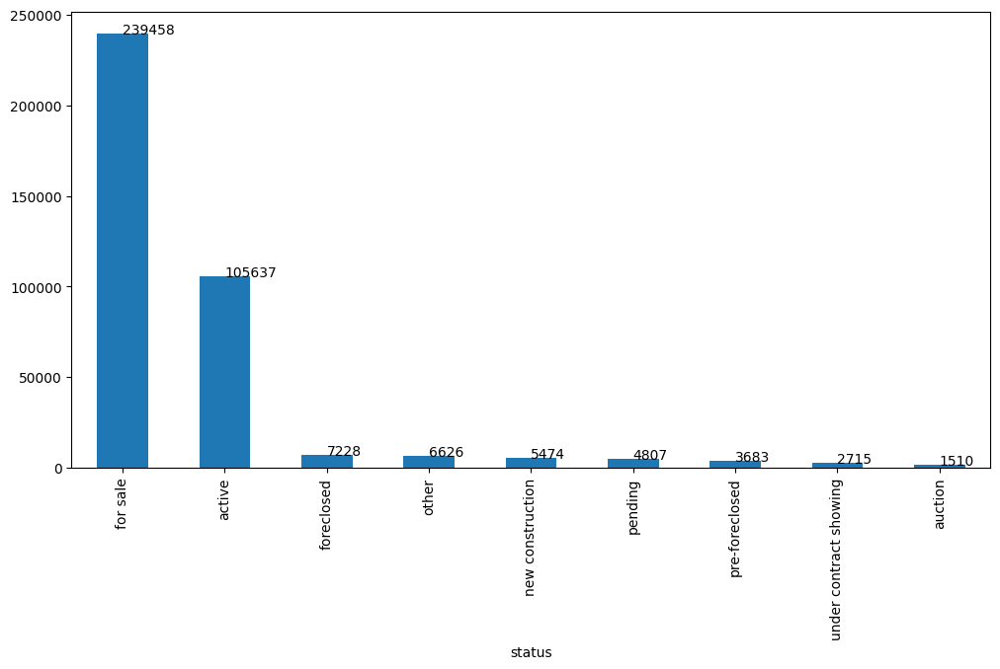

In [33]:
show_plot(data['status'])

### Признаки 'PrivatePool' и 'private pool'

Проверим содержание признаков

In [34]:
data['private pool'].value_counts()

private pool
Yes    4181
Name: count, dtype: int64

In [35]:
data['PrivatePool'].value_counts()

PrivatePool
yes    28792
Yes    11518
Name: count, dtype: int64

In [36]:
# сделаем признак бинарным, где 1 будет означать наличие бассейна, а 0 его отсутствие
data['private pool'] = data['private pool'].apply(lambda x: 1 if x=='Yes' else 0)
data['PrivatePool'] = data['PrivatePool'].apply(lambda x: 1 if (x=='Yes' or x=='yes') else 0)

In [37]:
# Объединим два признака:
data['private_pool'] = data['private pool'] | data['PrivatePool']
# Удалим отработанные колонки
data.drop(['private pool', 'PrivatePool'], axis=1, inplace=True)

In [38]:
data['private_pool'].value_counts()

private_pool
0    332647
1     44491
Name: count, dtype: int64

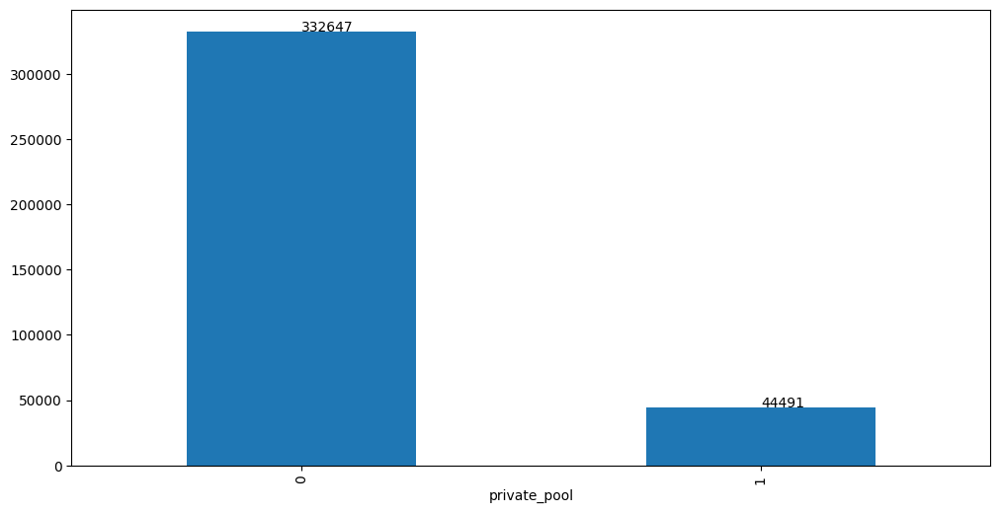

In [39]:
show_plot(data['private_pool'])

### Признак 'fireplace'

In [40]:
print("Количество пропусков: ", data['fireplace'].isnull().sum())
print("Количество уникальных значений: ", data['fireplace'].nunique())

Количество пропусков:  274038
Количество уникальных значений:  1652


In [41]:
data['fireplace'].value_counts()[:50]

fireplace
yes                                                                         50344
Yes                                                                         20856
1                                                                           14542
2                                                                            2432
Not Applicable                                                               1993
Fireplace                                                                     847
3                                                                             564
Living Room                                                                   433
LOCATION                                                                      399
Wood Burning                                                                  311
Gas/Gas Logs                                                                  300
No                                                                            289
Firepl

В столбце содержится 1652 уникальных значения и более 274 тыс пропусков. Будет логичным сделать допущение, что пропуск означает отсутствие камина. Поэтому заполним все пропуски значением 'no'.

In [42]:
data['fireplace'] = data['fireplace'].fillna('no')

Некоторые значения имеют различное написание, но одинаковый смысл. Приведём их к единообразию. Для начала приведём всё к нижнему регистру. Заменим значение '0', 'not applicable' и все что начинается на 'ceiling fan' на 'no'

In [43]:
data['fireplace'] = data['fireplace'].apply(lambda x: str(x).lower())
data['fireplace'] = data['fireplace'].apply(lambda x: 'no' if x=='0' else x)
data['fireplace'] = data['fireplace'].apply(lambda x: 'no' if x=='not applicable' else x)
data['fireplace'] = data['fireplace'].apply(lambda x: 'no' if x.startswith('ceiling fan') else x)

data['fireplace'].value_counts()[:50]

fireplace
no                                  277788
yes                                  71200
1                                    14542
2                                     2432
fireplace                              847
3                                      564
living room                            433
location                               399
wood burning                           311
gas/gas logs                           300
fireplace yn                           287
special features                       279
1 fireplace                            274
familyrm                               246
fireplace features                     239
great room                             207
wood                                   206
gas logs, great room                   188
living room, wood burning              185
4                                      184
family room, wood burning              149
familyrm, gas logs                     146
gas                                    134
g

Большинство оставшихся значений в той или иной мере описывают количество или тип камина, поэтому предлагается заменить все эти значения просто на факт его наличия. Также сделаем признак бинарным: 0 - камин отсутствует, 1 - наличие камина.

In [44]:
data['fireplace'] = data['fireplace'].apply(lambda x: 1 if x!='no' else 0)

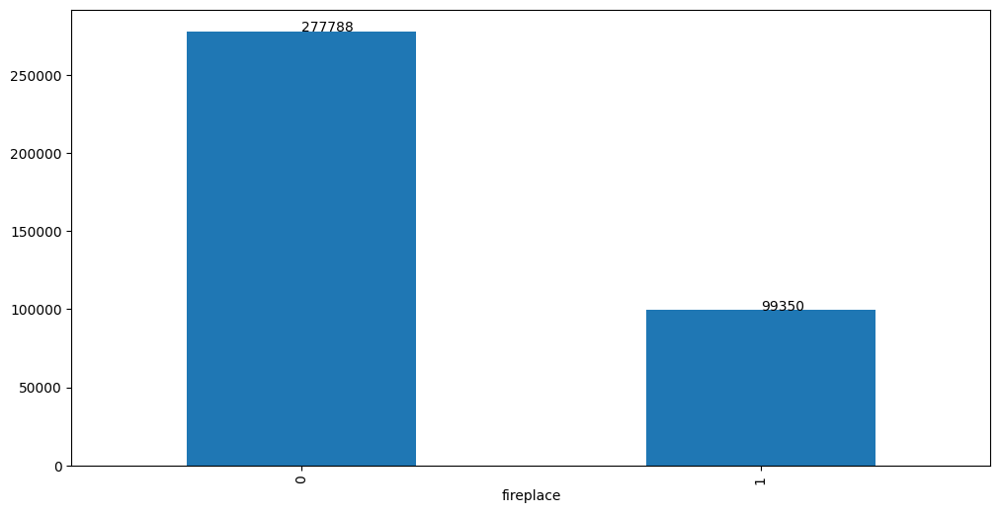

In [45]:
show_plot(data['fireplace'])

### Признак 'propertyType'

In [46]:
print("Количество пропусков: ", data['propertyType'].isnull().sum())
print("Количество уникальных значений: ", data['propertyType'].nunique())

Количество пропусков:  34725
Количество уникальных значений:  1280


Столбец имеет 1280 уникальных значений и 34725 пропусков (более 9%).\
Некоторые значения имеют разнообразное написание, но одинаковый смысл (причем можно ввстретить написание как в нижнем регистре, так и в верхнем). Необходимо унифицировать значения признака, как минимум приведя их к нижнему регистру.\
Так как пропусков достаточно много, заполним их самым популярным значением 'single-family home'

In [47]:
data['propertyType'] = data['propertyType'].fillna('single-family home')

Для начала приведём всё к нижнему регистру и объединим самые популярные признаки:
- все что начинается на "single" отнесем "single-family home"
- все что начинается на "condo"отнесем к "condo"
- сведем под одним названнием аппартаменты
- сведем под одним названием дома для нескольких семей
- сведем под одним названием мобильные/переносные дома

In [48]:
data['propertyType'] = data['propertyType'].apply(lambda x: str(x).lower())

data['propertyType'] = data['propertyType'].apply(lambda x: 'single-family home' if x.startswith('single detached') else  x)
data['propertyType'] = data['propertyType'].apply(lambda x: 'single-family home' if x == 'single family' else  x)
data['propertyType'] = data['propertyType'].apply(lambda x: 'condo' if x.startswith('condo') else  x)
data['propertyType'] = data['propertyType'].apply(lambda x: 'apartment' if x.startswith('apartment') else  x)
data['propertyType'] = data['propertyType'].apply(lambda x: 'coop' if x.startswith('co-op') else  x)

old = ['single family home', 'singlefamilyresidence', 'multi-family home', 'multi family', 'garden apartment', 'lot/land', 
       'cooperative', 'mobile/manufactured', 'mobile / manufactured', 'mfd/mobile home', 'manufactured home, mobile home, ranch',
       'modular/prefab, manufactured home, mobile home', 'single-wide mobile with land', 'single detached, single-wide mobile with land',
       'mobile home 1 story', 'single-wide mobile with land, traditional', 'manuf/mobile, ranch',
       'one', 'two', '2-', 'stories', '1 1/2', 'tri-', 'less than 4 story']
new = ['single-family home','single-family home', 'multi-family', 'multi-family', 'apartment', 'land', 
       'coop', 'mobile home', 'mobile home', 'mobile home', 'mobile home', 'mobile home', 'mobile home', 'mobile home', 'mobile home', 
       'mobile home', 'mobile home',
       '1', '2', '2 ', 'story',  '1.5', '3 ', '3 story']

for i in range(0, len(new)):
    data['propertyType'] = data['propertyType'].apply(lambda x: x.replace(old[i], new[i]))
 
print(data.propertyType.nunique())  
data.propertyType.value_counts()[:50]


1059


propertyType
single-family home                  224798
condo                                51447
land                                 31483
townhouse                            18389
multi-family                         12215
traditional                           5913
coop                                  3841
mobile home                           3489
1 story                               1826
high rise                             1822
ranch                                 1781
detached, 1 story                     1614
contemporary                          1557
2 story                               1507
colonial                              1204
contemporary/modern                   1000
apartment                              945
detached, 2 story                      637
transitional                           560
florida                                530
bungalow                               442
farms/ranches                          371
garden home                            30

В признаке 'propertyType' много сведений об этажности домов.\
Выделим эту информацию, и дополним ей признак 'stories', в которм много пропущенных значений.

In [49]:
# Создаем временный признак 'temp_stories'
data['temp_stories'] = data['propertyType'].apply(lambda x: 'no' if x.find('story') == -1 else x)

In [50]:
data['temp_stories'].value_counts()

temp_stories
no                                           369484
1 story                                        1826
detached, 1 story                              1614
2 story                                        1507
detached, 2 story                               637
                                              ...  
ranch, 1 story, split-level                       1
1 story, modern                                   1
3+ story, texas hill country                      1
2 story, traditional, other (see remarks)         1
3+ story, contemporary, traditional               1
Name: count, Length: 204, dtype: int64

In [51]:
# Выделим индексы строк, имеющие данные об этажности
temp_stories_index = data[data['temp_stories'] != 'no'].index
temp_stories_index

Index([    15,     98,    115,    166,    182,    197,    215,    304,    377,
          513,
       ...
       376564, 376573, 376645, 376652, 376763, 376765, 376867, 376936, 377072,
       377077],
      dtype='int64', length=7654)

Т.е. 7654 строки во временном поле с этажностью содержат сведения об этажности

In [52]:
print("Количество пропусков: ", data['stories'][temp_stories_index].isnull().sum())
print("Количество уникальных значений: ", data['stories'][temp_stories_index].nunique())

Количество пропусков:  7609
Количество уникальных значений:  5


При этом в этих же строках в настоящем поле с этажностью содержится более 7600 пропусков!\
Будет целесообразным заполнить эти пустые значения из временного поля с этажностью

In [53]:
# Оставим сведения относящиеся к этажности и запишем в признак 'stories'
def story(x):
    s = x.split(',')
    se = ''
    for i in range(0, len(s)):
        if s[i].find('story') != -1:
            se = s[i]
    return se.strip()

data.loc[temp_stories_index, 'stories'] = data['temp_stories'][temp_stories_index].apply(story)

print("Количество пропусков: ", data['stories'][temp_stories_index].isnull().sum())
print("Количество уникальных значений: ", data['stories'][temp_stories_index].nunique())
data['stories'][temp_stories_index].value_counts()

Количество пропусков:  0
Количество уникальных значений:  16


stories
1 story                    4331
2 story                    2919
1 story with basement        98
low-rise (1-3 story)         90
2 story with basement        68
3+ story                     44
high-rise (8+ story)         38
1.5 story with basement      21
mid-rise (4-7 story)         15
1.5 story                    13
1 story/ranch                 7
3 story                       6
coastal 2 story               1
2.5 story                     1
2 story condo                 1
1 story traditional           1
Name: count, dtype: int64

Вернемся к нашему признаку propertyType

In [54]:
data['propertyType'][temp_stories_index].value_counts()[:50]

propertyType
1 story                                                  1826
detached, 1 story                                        1614
2 story                                                  1507
detached, 2 story                                         637
2 story, traditional                                      289
1 story, traditional                                      237
2 story, contemporary                                     136
1 story, contemporary                                      96
low-rise (1-3 story)                                       90
ranch, 1 story                                             87
detached, ranch, 1 story                                   81
detached, 2 story, spanish/mediterranean                   67
1 story with basement                                      60
detached, 1 story, spanish/mediterranean                   53
1 story, ranch                                             46
high-rise (8+ story)                                     

In [55]:
# Удаляем сведения, относящихся к этажности для перезаписи в признак 'propertyType'
def del_story_info(x):
    s = x.split(',')
    for i in range(0, len(s)):
        if s[i].find('story') != -1:
            if len(s) == 1 and i == 0:
                s[i] = 'other'
            if len(s) > 1:
                s[i] = ' '
            if len(s) > 1 and i == 0:
                s[i] = ''
        x = ''.join(s).strip()
    return x

data.loc[temp_stories_index, 'propertyType'] = data['temp_stories'][temp_stories_index].apply(del_story_info)

print("Количество пропусков: ", data['propertyType'][temp_stories_index].isnull().sum())
print("Количество уникальных значений: ", data['propertyType'][temp_stories_index].nunique())
data['propertyType'][temp_stories_index].value_counts()[:50]

Количество пропусков:  0
Количество уникальных значений:  107


propertyType
other                                             3616
detached                                          2257
traditional                                        540
contemporary                                       258
ranch                                              140
detached  spanish/mediterranean                    120
detached ranch                                      86
craftsman                                           57
historic/older                                      57
mediterranean                                       45
spanish/mediterranean                               41
texas hill country                                  28
contemporary traditional                            23
detached patio home                                 19
other (see remarks)                                 19
modern                                              16
ranch traditional                                   16
detached  split-level                               

In [56]:
# удаляем временный признак
data.drop('temp_stories', axis=1, inplace=True)

Посмотрим на оставшиеся самые популярные значения признака типа дома:

In [57]:
data['propertyType'].value_counts()[:50]

propertyType
single-family home                  224798
condo                                51447
land                                 31483
townhouse                            18390
multi-family                         12215
traditional                           6453
other                                 3848
coop                                  3841
mobile home                           3489
detached                              2338
ranch                                 1921
high rise                             1822
contemporary                          1815
colonial                              1210
contemporary/modern                   1000
apartment                              945
transitional                           560
florida                                531
bungalow                               442
farms/ranches                          371
spanish/mediterranean                  313
garden home                            305
cape cod                               28

In [58]:
# дома типа detached отнесем к типу single-family home
data['propertyType'] = data['propertyType'].apply(lambda x: 'single-family home' if x.startswith('detached') else  x)
data['propertyType'].value_counts()[:50]

propertyType
single-family home                  227467
condo                                51447
land                                 31483
townhouse                            18390
multi-family                         12215
traditional                           6453
other                                 3848
coop                                  3841
mobile home                           3489
ranch                                 1921
high rise                             1822
contemporary                          1815
colonial                              1210
contemporary/modern                   1000
apartment                              945
transitional                           560
florida                                531
bungalow                               442
farms/ranches                          371
spanish/mediterranean                  313
garden home                            305
cape cod                               288
craftsman                              25

Далее в полях признака 'propertyType' оставляем основные типы домов, жилищ

In [59]:
# Присвоим полям новые названия в соответствии с найденной подстрокой
types = ['mediterranean', 'english', 'georgian', 'florida', 'spanish', 'lake house', 'tudor', 'victorian', 'ranch', 'townhouse', 
        'single-family','multi-family', 'high-rise', 'colonial', 'traditional', 'condo', 'contemporary', 'other style', 'bungalow', 
        'craftsman', 'cape cod','cooperative', 'a-frame',  'custom', 'loft', 'multi-level', 'attached', 'manufactured',  'side-by-side', 
        'cottage',  'french', 'cluster home', 'garden home', 'farmhouse', 'elevated',  'historical', 'transitional','penthouse','modern']

for i in range(0, len(types)):
    data['propertyType'] = data['propertyType'].apply(lambda x: x if x.find(types[i]) == -1 else types[i])
    
data['propertyType'].value_counts()[:50]

propertyType
single-family            227467
condo                     51469
land                      31483
townhouse                 18559
multi-family              12217
traditional                7183
other                      3848
coop                       3841
mobile home                3489
contemporary               3252
ranch                      2830
high rise                  1822
colonial                   1343
apartment                   945
florida                     749
mediterranean               680
transitional                570
bungalow                    552
garden home                 334
craftsman                   322
cape cod                    293
other style                 254
cluster home                159
multiple occupancy          158
custom                      150
victorian                   137
penthouse                   131
modern                      126
                            124
spanish                     121
other (see remarks)        

Проверим, какую долю от всех записей занимают ТОП-10,15, 20, 25 записей.

In [60]:
print("TOP-10: ", data['propertyType'].value_counts(normalize=True).nlargest(10).sum())
print("TOP-15: ", data['propertyType'].value_counts(normalize=True).nlargest(15).sum())
print("TOP-20: ", data['propertyType'].value_counts(normalize=True).nlargest(20).sum())
print("TOP-25: ", data['propertyType'].value_counts(normalize=True).nlargest(25).sum())

TOP-10:  0.9620032985273296
TOP-15:  0.982391061096999
TOP-20:  0.9889085692770285
TOP-25:  0.9915972402674882


С целью уменьшения числа категорий, выберем ТОП-10 типов жилья, а остальные занесем в категорию 'other'

In [61]:
top_10 = data['propertyType'].value_counts()[:10].index
data['propertyType'] = data['propertyType'].apply(lambda x: x if x in top_10 else 'other')

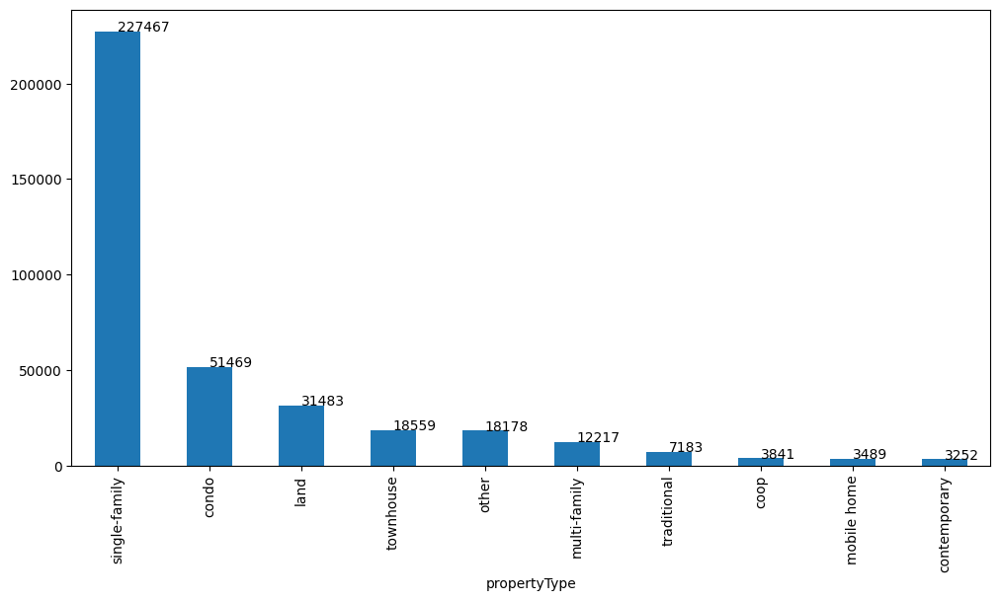

In [62]:
show_plot(data['propertyType'])

In [63]:
# cделаем копию наших данных, после частичной их обработки
data_copy = data.copy()

### Признак 'stories'

In [64]:
print("Количество пропусков: ", data['stories'].isnull().sum())
print("Количество уникальных значений: ", data['stories'].nunique())

Количество пропусков:  143080
Количество уникальных значений:  363


Признак имеет 363 уникальных значения и 143 тыс пропусков.

Выведем модальные значения этажности для каждого типа жилья

In [65]:
property_types = data['propertyType'].unique().tolist()
for prop_type in property_types:
    print('Самая популярная этажность для: ', prop_type, ' - ', data[data['propertyType'] == prop_type]['stories'].mode()[0])

Самая популярная этажность для:  single-family  -  1.0
Самая популярная этажность для:  land  -  1.0
Самая популярная этажность для:  townhouse  -  2.0
Самая популярная этажность для:  other  -  1 story
Самая популярная этажность для:  coop  -  6.0
Самая популярная этажность для:  multi-family  -  2.0
Самая популярная этажность для:  condo  -  1.0
Самая популярная этажность для:  mobile home  -  1.0
Самая популярная этажность для:  contemporary  -  2
Самая популярная этажность для:  traditional  -  2


In [66]:
# заполним пока пустые значения нулевым значением
data['stories'] = data['stories'].fillna('0')
# приведем все к нижнему регистру
data['stories'] = data['stories'].apply(lambda x: x.lower())
data['stories'].unique().tolist()

['0',
 '2.0',
 '1.0',
 '3.0',
 'one',
 '2',
 '2 story',
 'multi/split',
 '4.0',
 '0.0',
 'one level',
 '1',
 '9.0',
 '1 story',
 '3',
 '1 level, site built',
 'one story',
 '3.00',
 '1.00',
 '14.0',
 'two',
 '3+',
 '5.0',
 'ranch/1 story',
 'condominium',
 'stories/levels',
 '7.0',
 '2 level, site built',
 '2 level',
 '15',
 '3 level, site built',
 '4',
 '22.0',
 '2.00',
 '6.0',
 'low-rise (1-3 story)',
 '1.0000',
 'lot',
 '3 story',
 'three or more',
 '1.5',
 '1 level',
 'two story or more',
 'site built, tri-level',
 '54.0',
 '23',
 'farm house',
 '8.0',
 '16.0',
 '1.50',
 '18',
 '9',
 '21',
 '8',
 '12.0',
 'split level w/ sub',
 '11.0',
 '18.0',
 '1.5 stories',
 '7',
 '11',
 'townhouse',
 '12',
 '21.0',
 '16',
 '1.5 story/basement',
 '28.0',
 'traditional',
 '2.5 story',
 '17',
 '2.0000',
 '63.0',
 'acreage',
 'ground level, one',
 '6',
 'split foyer',
 '2 stories',
 '27.0',
 '19.0',
 '2.50',
 '1.30',
 '2 story/basement',
 'split level',
 '1.5 story',
 '1.5 level',
 '2 or more stori

Проведем обработку признака через унификацию значений и приведение их к числовым значениям

In [67]:
old_text = ['one', 'two', 'bi', 'split', 'three', 'tri', 'four', 'quad', 'stories',
           '-level', 'levels', 'leveland', '1 and 1 half', '1 1/2 story', '1 1/2 level', 'acreage',
           '1-2 story', '3-4 story', '3 - 5 story']
new_text = ['1', '2', '2', '2', '3', '3', '4', '4', 'story',
           ' level', 'level', 'level and', '1.5 story', '1.5 story', '1.5 story', '0',
           '2', '3', '4']
for i in range(0, len(new_text)):
    data['stories'] = data['stories'].apply(lambda x: x.replace(old_text[i], new_text[i]))

In [68]:
one_story_houses = ['condo', 'traditional', 'contemporary', 
             'mo2le', 'ground level', 'modular home', 'craftsman']
def change_story(x):
    if x.find('townhouse') != -1 or x.find('multi level') != -1 or x.find('low-rise') != -1:
        x = '2'
    if x in one_story_houses:
        x = '1'
    if x.find('condo') != -1:
        x = '1'       
    if x.find('mid-rise') != -1:
        x = '5'
    if x.find('high-rise') != -1:
        x = '9'
    return x

data['stories'] = data['stories'].apply(change_story)  

In [69]:
def stories_to_float(x):
    if x.startswith(','): x = x[1:]
    if x == -1.0: return x
    x = re.sub('[^0-9,-\.]', '', x)
    x = re.sub('-',',', x)
    x = x.replace(',,',',0,')
    x = x.split(',')
    try:
        x = (max([float(item) for item in x]))
    except:
        x =0
    return x

data['stories'] = data['stories'].apply(stories_to_float)

Проверим этажность больше 100, это явно ошибка

In [70]:
data[data['stories'] > 100]

,status,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,MlsId,target,ZIP,LAT,LNG,private_pool
222902,for sale,condo,311 W Ashley St APT 1111,Bathrooms: 1,"{'atAGlanceFacts': [{'factValue': '1949', 'fac...",0,Jacksonville,"[{'rating': ['4/10', '3/10'], 'data': {'Distan...",Total interior livable area: 425 sqft,32202,-- bd,FL,1120.0,974565,NaN,"$53,000",32202,30.324716,-81.647200,0
316595,for sale,townhouse,20277 Schaeffer Dr,Bathrooms: 3,"{'atAGlanceFacts': [{'factValue': '2006', 'fac...",1,Bend,"[{'rating': ['7/10', '3/10', '7/10'], 'data': ...","Total interior livable area: 1,497 sqft",97703,3 bd,OR,1002.0,201909859,NaN,"$325,000",97703,44.000626,-121.233812,0


In [71]:
data['stories'].value_counts(normalize=True)[:20]

stories
0.0     0.414116
1.0     0.277779
2.0     0.227126
3.0     0.047402
9.0     0.009161
4.0     0.008329
1.5     0.003306
6.0     0.002683
5.0     0.002386
7.0     0.001074
8.0     0.000888
2.5     0.000522
12.0    0.000400
16.0    0.000316
11.0    0.000302
20.0    0.000278
Name: proportion, dtype: float64

Анализируя данные в столбце с этажностью можно увидеть, что в значениях имеется более 41% пустых (нулевых) значений.\
Предлагается заменить их наиболее часто встречающимися значениями (модальными) в взависимости от типов домов, особенно когда это явно видно.

In [72]:
data['stories'] = data['stories'].apply(lambda x: np.nan if ((x == 0) | (x > 100)) else x)

In [73]:
data[data['stories'].isnull()]['propertyType'].value_counts()

propertyType
single-family    76530
land             29520
condo            23045
other             9615
multi-family      5588
townhouse         4722
traditional       2278
mobile home       1861
coop              1756
contemporary      1266
Name: count, dtype: int64

Что видим:\
дома single-family это как правило маленькие семейные отдельностоящие дома, поэтому для них предлагается заполнить пропуски значением 1.\
Земли - тут ни о какой этажности речь не идет, оставляем 0\
townhouse - как правило двухэтажные.\
mobile home - одноэтажные\
traditional, multi-family и contemporary - двухэтажные\
other - сделаем одноэтажными\
кооперативные дома - как увидели ранее наиболее часто встречающийся этаж - шестой\
А вот для квартир предлагаю взять среднее значение:

In [74]:
round(data[data['propertyType'] == 'condo']['stories'].mean())

4

In [75]:
for prop_type in data['propertyType'].value_counts().index:
    mask = data['propertyType'] == prop_type
    if data[mask].isnull().sum()['stories'] > 0:
        if prop_type == 'contemporary' or prop_type == 'traditional' or prop_type == 'multi-family' or prop_type == 'townhouse':
            value = {'stories': 2}
            data[mask] = data[mask].fillna(value)
        if prop_type == 'single-family' or prop_type == 'other' or prop_type == 'mobile home':
            value = {'stories': 1}  
            data[mask] = data[mask].fillna(value)
        if prop_type == 'land':
            value = {'stories': 0}  
            data[mask] = data[mask].fillna(value)
        if prop_type == 'coop':
            value = {'stories': 6}  
            data[mask] = data[mask].fillna(value)  
        if prop_type == 'condo':
            value = {'stories': 4}  
            data[mask] = data[mask].fillna(value)                       

In [76]:
print(data['stories'].value_counts(normalize=True)[:10].sum())
data['stories'].value_counts(normalize=True)[:10]

0.9972052670375301


stories
1.0     0.511131
2.0     0.263861
0.0     0.078274
4.0     0.069433
3.0     0.047402
9.0     0.009161
6.0     0.007339
1.5     0.003306
5.0     0.002386
7.0     0.001074
8.0     0.000888
2.5     0.000522
12.0    0.000400
16.0    0.000316
11.0    0.000302
20.0    0.000278
14.0    0.000249
15.0    0.000236
17.0    0.000231
13.0    0.000215
10.0    0.000199
Name: proportion, dtype: float64

В результате сложных манипуляций с большим числом грязных данных - унификацией и подбором замен, получили самые распространенные этажности жилья.\
Судя по значениям этого признака он описывает не только этажность продаваемого дома, но и этаж, на котором располагается квартира, в зависимости от типа продаваемого объекта.\

In [77]:
data['stories'].describe()

count    377138.000000
mean          1.743967
std           2.347879
min           0.000000
25%           1.000000
50%           1.000000
75%           2.000000
max          96.000000
Name: stories, dtype: float64

### Признак 'baths'

In [78]:
print("Количество пропусков: ", data['baths'].isnull().sum())
print("Количество уникальных значений: ", data['baths'].nunique())

Количество пропусков:  106320
Количество уникальных значений:  229


В столбце 229 уникальных значений и 106 тыс пропусков.

В результате детального анализа признака можем наблюдать различные способы записей. Унифицируем их

In [79]:
data['baths'] = data['baths'].apply(lambda x: str(x).lower())
# Удалим все буквы, поскольку нам важно только количество
data['baths'] = data['baths'].str.replace('[a-zA-Z]', '', regex=True)
# Удалим все пробелы
data['baths'] = data['baths'].str.replace(' ', '' )
# Удалим все :
data['baths'] = data['baths'].str.replace(':', '' )
# Удалим все + 
data['baths'] = data['baths'].str.replace('+', '')

print(data['baths'].nunique())  
data['baths'].value_counts()[:50]

136


baths
         106321
2         85140
3         54114
4         21449
2.0       16576
2.5       12891
3.0       10867
1         10573
5          7665
1.0        5930
3.5        5503
4.0        4593
0          3811
6          3566
1,500      2209
1.5        2154
2,000      1795
1,750      1722
7          1716
3,000      1686
4.5        1560
5.0        1557
2,250      1442
1,000      1279
1,250      1208
2,750       964
8           943
2,500       894
~           782
6.0         737
3,500       653
5.5         522
--          509
9           442
7.0         362
4,000       290
10          273
750         237
5,000       230
8.0         216
..          202
6.5         193
11          157
12          113
9.0         104
1.75         93
7.5          65
0/0          63
13           58
10.0         55
Name: count, dtype: int64

In [80]:
data['baths'] = data['baths'].fillna('none')
data['baths'] = data['baths'] \
.str.replace('~','none') \
.str.replace('--','none') \
.str.replace('0/0','0') \
.str.replace('1-0/1-0/1','3') \
.str.replace('116/116/116','116') \
.str.replace('3-1/2-2','3') \
.str.replace('1/1/1/1','4') \
.str.replace('2-1/2-1/1-1/1-1','4') \
.str.replace('1/1-0/1-0/1-0','4')  \
.str.replace('1/3-0','3') \
.str.replace('1-2','2') \
.str.replace('..', 'none') \
.str.replace('—', 'none')

Встречаются записи как целые числа, так и через точку и запятую.\
В штатах есть интересная особенность, что ванные комнаты могут обозначаться дробным числом, например 1.5. Это значит что есть одна полноценная ванная (душ, туалет, ванная, раковина), а есть еще ванная только с душем и раковиной.\
Как правило количество ванных четно 0.25\
Также есть значения с запятой и 3 знаками после нее, которые по смыслу означают тысячи. Но как может быть тысяча ванн? Отдельно проанализировав такие записи, делаем допущение, что это ошибка и предлагается запяую просто заменить на точку. 

In [81]:
data['baths'] = data['baths'].str.replace(',','.')
data['baths'] = data['baths'].apply(lambda x: 'none' if x == '' else x)

Теперь все числовые значения, записанные как строки преобразуем в числа (кроме none)

In [82]:
data['baths'] = data['baths'].apply(lambda x: x if x == 'none' else float(x))

Проверим записи с большим количеством ванн\
От 50 до 100 ванн - скорее всего данные соответствуют действительности, т.к. это дома с высокой стоимостью и большой площадью.\
От 100 ванн - скорее всего ошибка, предлагается просто удалить эти данные.\
И есть набор записей, где количество ванных составляет 750.

In [83]:
data[data['baths'] == 750]['propertyType'].value_counts()

propertyType
condo            123
single-family     63
contemporary      30
other             15
traditional        5
townhouse          1
Name: count, dtype: int64

Исходя из того что преимущественно такое количество относится к кондоминимумам и небольшим односемейным домам, можно сделать вывод, что это ошибка и на самом деле число ванн = 0.75

In [84]:
data = data.drop(data[(data['baths'] == 116) | (data['baths'] == 241)].index)
data['baths'] = data['baths'].apply(lambda x: 0.75 if x == 750 else x)

Перейдем теперь к заполнению пустых значений, которые ранее мы обозначили как "none".\
Для упрощения вернем пустые значения вместо none.\
Предлагается для каждой категории жилья оценить медианное количество ванн и этими значениями заполнить пустоты.\
Для начала проверим что это за значения:

In [85]:
data['baths'] = data['baths'].apply(lambda x: np.nan if x == 'none' else x)

In [86]:
for i in data['propertyType'].unique().tolist():
    mask = data.propertyType == i
    bath_qty_mean = data[mask]['baths'].mean()
    bath_qty_median = data[mask]['baths'].median()
    bath_qty_mode = data[mask]['baths'].mode()[0]
    print(f'Количество ванн для типа жилья {i} составляет: среднее - {bath_qty_mean:.2f}, медиана - {bath_qty_median}, мода {bath_qty_mode}')

Количество ванн для типа жилья single-family составляет: среднее - 2.83, медиана - 2.5, мода 2.0
Количество ванн для типа жилья land составляет: среднее - 0.36, медиана - 0.0, мода 0.0
Количество ванн для типа жилья townhouse составляет: среднее - 2.94, медиана - 3.0, мода 3.0
Количество ванн для типа жилья other составляет: среднее - 2.14, медиана - 2.0, мода 2.0
Количество ванн для типа жилья coop составляет: среднее - 2.23, медиана - 2.0, мода 2.0
Количество ванн для типа жилья multi-family составляет: среднее - 3.74, медиана - 3.0, мода 2.0
Количество ванн для типа жилья condo составляет: среднее - 2.31, медиана - 2.0, мода 2.0
Количество ванн для типа жилья mobile home составляет: среднее - 1.98, медиана - 2.0, мода 2.0
Количество ванн для типа жилья contemporary составляет: среднее - 2.08, медиана - 2.0, мода 1.5
Количество ванн для типа жилья traditional составляет: среднее - 2.30, медиана - 2.25, мода 2.25


В результате анализа предлагается заменить пустые значения медианными значениями в зависимости от типов жилья

In [87]:
for prop_type in data['propertyType'].value_counts().index:
    mask = data['propertyType'] == prop_type
    if data[mask].isnull().sum()['baths'] > 0:
        value = {'baths': data[mask]['baths'].median()}
        data[mask] = data[mask].fillna(value)
    
print("Количество пропусков: ", data['baths'].isnull().sum())
print("Количество уникальных значений: ", data['baths'].nunique())
data['baths'].value_counts()[:30]

Количество пропусков:  0
Количество уникальных значений:  81


baths
2.00     129154
3.00      70794
2.50      59543
0.00      31085
4.00      26334
1.00      17782
5.00       9452
2.25       6585
3.50       6156
1.50       4363
6.00       4303
7.00       2078
1.75       1815
4.50       1560
1.25       1216
8.00       1159
2.75        999
9.00        546
5.50        522
10.00       328
0.75        239
6.50        193
11.00       187
12.00       134
7.50         84
13.00        74
2.10         53
16.00        52
14.00        45
18.00        32
8.50         31
15.00        28
24.00        17
1.10         17
20.00        16
10.50        14
3.10         12
3.25         11
22.00        10
17.00        10
26.00         8
3.75          8
23.00         8
9.50          6
30.00         6
Name: count, dtype: int64

В оставшихся данных встречаются цифры, которые не кратны 0.25. Предлагается сделать их таковыми:

In [88]:
data['baths'] = data['baths'].apply(lambda x: round(x * 4) / 4)

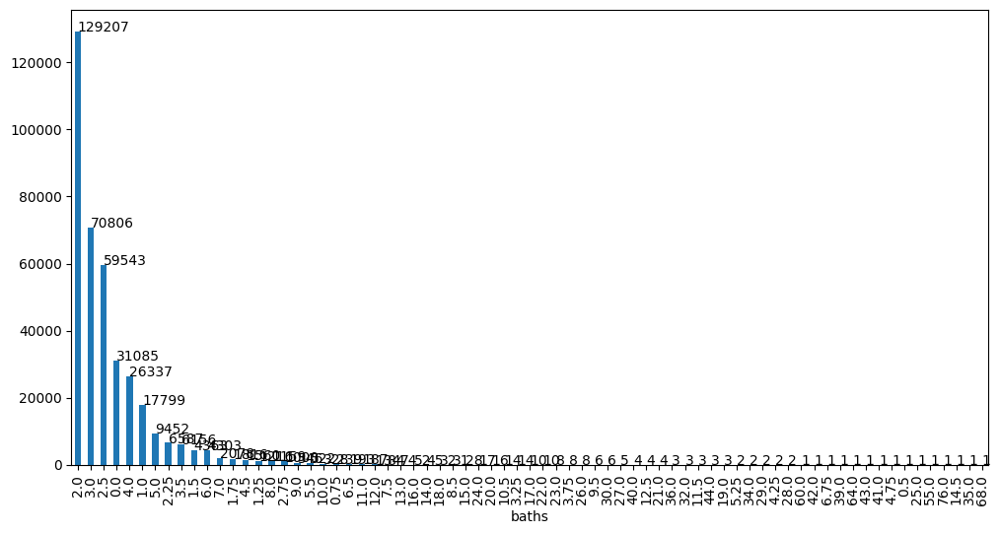

In [89]:
show_plot(data['baths'])

In [90]:
data['baths'].describe()

count    377136.000000
mean          2.442595
std           1.412761
min           0.000000
25%           2.000000
50%           2.250000
75%           3.000000
max          76.000000
Name: baths, dtype: float64

### Признак 'homeFacts'

In [91]:
print("Количество пропусков: ", data['homeFacts'].isnull().sum())
print("Количество уникальных значений: ", data['homeFacts'].nunique())

Количество пропусков:  0
Количество уникальных значений:  320969


In [92]:
data['homeFacts'].value_counts()

homeFacts
{'atAGlanceFacts': [{'factValue': '', 'factLabel': 'Year built'}, {'factValue': '', 'factLabel': 'Remodeled year'}, {'factValue': '', 'factLabel': 'Heating'}, {'factValue': '', 'factLabel': 'Cooling'}, {'factValue': '', 'factLabel': 'Parking'}, {'factValue': '—', 'factLabel': 'lotsize'}, {'factValue': None, 'factLabel': 'Price/sqft'}]}                                                        7173
{'atAGlanceFacts': [{'factValue': None, 'factLabel': 'Year built'}, {'factValue': None, 'factLabel': 'Remodeled year'}, {'factValue': None, 'factLabel': 'Heating'}, {'factValue': None, 'factLabel': 'Cooling'}, {'factValue': None, 'factLabel': 'Parking'}, {'factValue': None, 'factLabel': 'lotsize'}, {'factValue': None, 'factLabel': 'Price/sqft'}]}                                             3530
{'atAGlanceFacts': [{'factValue': '', 'factLabel': 'Year built'}, {'factValue': '', 'factLabel': 'Remodeled year'}, {'factValue': '', 'factLabel': 'Heating'}, {'factValue': '', 'factLabel': 'Coo

В данном признаке содержится словарь с различными параметрами дома:
- год постройки
- год реконструкции
- способ отопления
- способ охлаждения
- наличие парковки
- размер лота
- стоимость квадратного фута

Но этот словарь записан в виде строки и чтобы его инициализировать, применим функцию eval

In [93]:
data['homeFacts'] = data['homeFacts'].apply(eval)

Теперь вытащим все эти характеристики из словаря в отдельные признаки наших объектов недвижимости, а исходный признак-словарь удалим.

In [94]:
data['year_built'] = data['homeFacts'].apply(lambda x: x['atAGlanceFacts'][0]['factValue'])
data['remodeled_year'] = data['homeFacts'].apply(lambda x: x['atAGlanceFacts'][1]['factValue'])
data['heating'] = data['homeFacts'].apply(lambda x: x['atAGlanceFacts'][2]['factValue'])
data['cooling'] = data['homeFacts'].apply(lambda x: x['atAGlanceFacts'][3]['factValue'])
data['parking'] = data['homeFacts'].apply(lambda x: x['atAGlanceFacts'][4]['factValue'])
data['lotsize'] = data['homeFacts'].apply(lambda x: x['atAGlanceFacts'][5]['factValue'])
data['price/sqft'] = data['homeFacts'].apply(lambda x: x['atAGlanceFacts'][6]['factValue'])
data.drop(['homeFacts'], axis = 1, inplace = True)
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 377136 entries, 0 to 377178
Data columns (total 26 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   status          377136 non-null  object 
 1   propertyType    377136 non-null  object 
 2   street          377134 non-null  object 
 3   baths           377136 non-null  float64
 4   fireplace       377136 non-null  int64  
 5   city            377102 non-null  object 
 6   schools         377136 non-null  object 
 7   sqft            336568 non-null  object 
 8   zipcode         377136 non-null  object 
 9   beds            285869 non-null  object 
 10  state           377136 non-null  object 
 11  stories         377136 non-null  float64
 12  mls-id          24941 non-null   object 
 13  MlsId           310260 non-null  object 
 14  target          374655 non-null  object 
 15  ZIP             377136 non-null  int64  
 16  LAT             377136 non-null  float64
 17  LNG            

#### Признак 'year_built'

In [95]:
print("Количество пропусков: ", data['year_built'].isnull().sum())
print("Количество уникальных значений: ", data['year_built'].nunique())

Количество пропусков:  3611
Количество уникальных значений:  230


In [96]:
data['year_built'].unique()

array(['2019', '1961', '2006', '', '1920', '1976', '1970', '1965', '2015',
       '1996', '1982', '1905', '2008', '1899', '2016', '1954', '1989',
       '2014', '1915', '1994', '1910', '1923', '1960', '1977', '1972',
       '1963', '1981', '1949', '1930', '1991', '1958', '2005', '2017',
       '2018', '1983', '1928', '1998', '1997', '1964', '1974', '1940',
       '1973', '1968', '1999', '1918', '2007', '1984', '1946', '2003',
       '2000', '2004', '1969', '2002', '1952', '1947', '1957', '1978',
       '1956', '1967', '1975', '1988', '1955', '1950', '1959', '2012',
       '1924', '1966', '1992', '2001', '1995', '1985', '2010', '1971',
       '1909', '1953', '1993', '1990', '1980', '1951', '1907', '1885',
       '1941', '1927', '1929', '1901', None, '1922', '1906', '1945',
       '1979', '2009', '1962', '1913', '2011', '1897', '1987', '2020',
       '1926', '1939', '1925', '2013', '1986', 'No Data', '1943', '1935',
       '1890', '1900', '1895', '1911', '1948', '1942', '1916', '1931',
 

Признак года постройки содержит 230 уникальных значений и 3611 пропусков. А также следующие некорректные значения: '', 'No Data', '1', '559990649990' 

In [97]:
data['year_built'] = data['year_built'].apply(
    lambda x: None if (x == '1') | (x == '') | (x == '559990649990') | (x == 'No Data') else x)

In [98]:
data['year_built'].unique()

array(['2019', '1961', '2006', None, '1920', '1976', '1970', '1965',
       '2015', '1996', '1982', '1905', '2008', '1899', '2016', '1954',
       '1989', '2014', '1915', '1994', '1910', '1923', '1960', '1977',
       '1972', '1963', '1981', '1949', '1930', '1991', '1958', '2005',
       '2017', '2018', '1983', '1928', '1998', '1997', '1964', '1974',
       '1940', '1973', '1968', '1999', '1918', '2007', '1984', '1946',
       '2003', '2000', '2004', '1969', '2002', '1952', '1947', '1957',
       '1978', '1956', '1967', '1975', '1988', '1955', '1950', '1959',
       '2012', '1924', '1966', '1992', '2001', '1995', '1985', '2010',
       '1971', '1909', '1953', '1993', '1990', '1980', '1951', '1907',
       '1885', '1941', '1927', '1929', '1901', '1922', '1906', '1945',
       '1979', '2009', '1962', '1913', '2011', '1897', '1987', '2020',
       '1926', '1939', '1925', '2013', '1986', '1943', '1935', '1890',
       '1900', '1895', '1911', '1948', '1942', '1916', '1931', '1944',
       '

In [99]:
# преобразуем текстовые значения признака в числа
data['year_built'] = data['year_built'].apply(lambda x: int(x) if x != None else x)

In [100]:
data['year_built'].sort_values()[:10]

312868    1019.0
172721    1057.0
264050    1060.0
149922    1208.0
2410      1700.0
319152    1703.0
174109    1703.0
277403    1735.0
2064      1740.0
247990    1750.0
Name: year_built, dtype: float64

In [101]:
# проверим слишком старые дома где год постройки <  1700
data[data['year_built'] < 1700]

,status,propertyType,street,baths,fireplace,city,schools,sqft,zipcode,beds,...,LAT,LNG,private_pool,year_built,remodeled_year,heating,cooling,parking,lotsize,price/sqft
149922,other,single-family,648 N Mulberry St,2.0,0,Logan,"[{'rating': ['9', '6', '4', '6', 'NR', 'NR'], ...",1208,43138,3.0,...,39.518345,-82.414100,0,1208.0,,GAS FORCED AIR,,888,None,$65
172721,active,single-family,5532 NW 57th Pl,2.0,0,Ocala,"[{'rating': ['1', '4', '3', '1', '6', '5', 'NR...",1042,34482,2,...,29.244387,-82.275029,0,1057.0,,Central Electric,Central Electric,,8712,$101
264050,active,single-family,576 19th St,2.5,0,Brooklyn,"[{'rating': ['6', '8', '5', '6'], 'data': {'Di...","1,892",11218,NaN,...,40.643468,-73.976046,0,1060.0,1960,,,,"1,953 Sq. Ft.",$793 / Sq. Ft.
312868,active,other,Ellisway Rd #13,3.0,0,Charlotte,"[{'rating': [], 'data': {'Distance': [], 'Grad...","1,811",28216,Baths,...,35.312103,-80.888711,0,1019.0,,,"Heat Pump for A/C, Heat Pump for Heat",,—,$158 / Sq. Ft.


Дом, "построенный" в 1208 году явно ошибочный, т.к. в поле года занесли тоже число что и в площадь. А 3 остальных - скорее всего допустили ошибку ввода данных и вместо 9 набрали 0.

In [102]:
data[(data['year_built']> 2022)]

,status,propertyType,street,baths,fireplace,city,schools,sqft,zipcode,beds,...,LAT,LNG,private_pool,year_built,remodeled_year,heating,cooling,parking,lotsize,price/sqft
164164,active,traditional,2421 Flume Gate Ct,2.25,1,Raleigh,"[{'rating': ['5', '4', '3'], 'data': {'Distanc...","3,518",27603,NaN,...,35.664418,-78.652751,0,2025.0,,,,,—,$152 / Sq. Ft.
313502,active,traditional,2405 Flume Gate Ct,2.25,1,Raleigh,"[{'rating': ['5', '4', '3'], 'data': {'Distanc...","3,000",27603,NaN,...,35.664418,-78.652751,0,2025.0,,,,,0.77 Acres,$165 / Sq. Ft.


Также есть 2 дома, построенные в будущем - 2025 год )

In [103]:
# Заменим 0 на 9
data.loc[data['year_built']==1019,'year_built'] = 1919
data.loc[data['year_built']==1057,'year_built'] = 1957
data.loc[data['year_built']==1060,'year_built'] = 1960

data['year_built'] = data['year_built'].apply(lambda x: None if (x == 2025) | (x == 1208) else x)

In [104]:
print("Количество пропусков: ", data['year_built'].isnull().sum())
print("Количество уникальных значений: ", data['year_built'].nunique())

Количество пропусков:  63593
Количество уникальных значений:  221


Проверим какие типы объектов преимущественно содержат пропуски:

In [105]:
data[data['year_built'].isnull()]['propertyType'].value_counts()

propertyType
single-family    31936
land             26978
townhouse         2163
condo             1518
other              581
multi-family       209
coop                83
mobile home         58
traditional         34
contemporary        33
Name: count, dtype: int64

**Важное допущение**\
в нашем датасете есть достаточно большое количество записей с типом недвижимости LAND. Как раз для таких записей в признаке года постройки содержится большое количество пропусков, что и логично, т.к. объектом является земля, то на ней нет построек.\
Исходя из этого логично будет сделать вывод, что для данного типа объекта будут неприменимы следующие признаки:
- baths          
- fireplace      
- beds            
- stories       
- private_pool  
- year_built     
- remodeled_year  
- heating        
- cooling       
- parking

Таким образом объекты с типом LAND необходимо анализировать отдельно, на основе сокращенного перечня признаков\
Поэтому принимаем решение все записи с типом LAND переместить в отдельный датасет сделать для него отдельную модель (при наличии времени)

In [106]:
data_land = data[data['propertyType'] == 'land']
data = data[data['propertyType'] != 'land']

In [107]:
data['year_built'].value_counts().nlargest(20)

year_built
2019.0    32046
2006.0     7982
2005.0     7476
2007.0     7110
2018.0     6779
2004.0     5491
2017.0     5057
2008.0     4998
2016.0     4996
2003.0     4556
1950.0     4381
2002.0     4231
1920.0     4191
2001.0     4182
1925.0     4081
2015.0     3827
1955.0     3611
2000.0     3583
1960.0     3571
1974.0     3420
Name: count, dtype: int64

Что делать с оставшимися пропусками в признаке года постройки? Можно попробовать заменить на медианное или среднее значение всего признака. Но думаю, что более логичным будет заполнить пропуски медианным значением в зависимости от месторасположения объекта, т.е. от zip-кода. Т.к. в "микрорайоне" все дома примерно построены плюс-минус в одном десятилетии.

In [108]:
for zip_code in data['ZIP'].value_counts().index:
    mask = data['ZIP'] == zip_code
    if data[mask].isnull().sum()['year_built'] > 0:
        value = {'year_built': data[mask]['year_built'].median()}
        data[mask] = data[mask].fillna(value)
    
print("Количество пропусков: ", data['year_built'].isnull().sum())
print("Количество уникальных значений: ", data['year_built'].nunique())
data['year_built'].value_counts().nlargest(20)

Количество пропусков:  100
Количество уникальных значений:  308


year_built
2019.0    33525
2005.0     9313
2006.0     9288
2007.0     8939
2018.0     7786
2004.0     6199
2017.0     5989
2016.0     5890
2008.0     5712
1920.0     5437
2003.0     5401
2001.0     4918
1950.0     4752
2002.0     4734
2015.0     4685
1925.0     4369
2000.0     4184
1955.0     3965
1999.0     3963
1960.0     3801
Name: count, dtype: int64

Все-таки у нас еще 100 пропущенных значений. Их уже предлагается заполнить медианой всего признака:

In [109]:
value = {'year_built': data['year_built'].median()}
data = data.fillna(value)
print("Количество пропусков: ", data['year_built'].isnull().sum())
print("Количество уникальных значений: ", data['year_built'].nunique())
data['year_built'].unique()

Количество пропусков:  0
Количество уникальных значений:  308


array([2019. , 1961. , 2006. , 1920. , 1976. , 1970. , 1965. , 2015. ,
       1996. , 1982. , 1905. , 2008. , 1899. , 2016. , 1954. , 1989. ,
       2014. , 1915. , 1981. , 2013. , 1994. , 1910. , 1923. , 1960. ,
       1977. , 1972. , 1963. , 1949. , 1930. , 2005. , 2010. , 1991. ,
       1958. , 2017. , 1993. , 2018. , 1983. , 1928. , 1998. , 1997. ,
       1992. , 1964. , 1940. , 1973. , 1968. , 1999. , 1918. , 2007. ,
       1984. , 1946. , 2010.5, 2003. , 2000. , 2004. , 1969. , 1998.5,
       2002. , 1952. , 1974. , 1947. , 1957. , 1978. , 1956. , 1967. ,
       1980. , 1975. , 1988. , 1955. , 1950. , 1959. , 2012. , 1924. ,
       1966. , 2001. , 1995. , 1985. , 1971. , 1909. , 1953. , 1990. ,
       1931. , 1951. , 1907. , 1885. , 1941. , 1987.5, 1927. , 1929. ,
       1901. , 1922. , 1906. , 1945. , 1979. , 2009. , 1962. , 1913. ,
       2011. , 2017.5, 1897. , 1987. , 2020. , 1926. , 1939. , 1964.5,
       1925. , 1986. , 1991.5, 1943. , 1935. , 1890. , 1900. , 1895. ,
      

Видим, что у нас появились нецелые значения. Вероятнее всего они появились на этапе расчета медианы для отдельных местоположений. Округлим эти значения и приведем признак к целому типу.

In [110]:
data['year_built'] = data['year_built'].apply(lambda x: int(round(x)))
print("Количество пропусков: ", data['year_built'].isnull().sum())
print("Количество уникальных значений: ", data['year_built'].nunique())
data['year_built'].unique()

Количество пропусков:  0
Количество уникальных значений:  220


array([2019, 1961, 2006, 1920, 1976, 1970, 1965, 2015, 1996, 1982, 1905,
       2008, 1899, 2016, 1954, 1989, 2014, 1915, 1981, 2013, 1994, 1910,
       1923, 1960, 1977, 1972, 1963, 1949, 1930, 2005, 2010, 1991, 1958,
       2017, 1993, 2018, 1983, 1928, 1998, 1997, 1992, 1964, 1940, 1973,
       1968, 1999, 1918, 2007, 1984, 1946, 2003, 2000, 2004, 1969, 2002,
       1952, 1974, 1947, 1957, 1978, 1956, 1967, 1980, 1975, 1988, 1955,
       1950, 1959, 2012, 1924, 1966, 2001, 1995, 1985, 1971, 1909, 1953,
       1990, 1931, 1951, 1907, 1885, 1941, 1927, 1929, 1901, 1922, 1906,
       1945, 1979, 2009, 1962, 1913, 2011, 1897, 1987, 2020, 1926, 1939,
       1925, 1986, 1943, 1935, 1890, 1900, 1895, 1911, 1948, 1942, 1916,
       1944, 1893, 1879, 1914, 1937, 1912, 1938, 1921, 1860, 1850, 1936,
       1861, 1880, 1908, 1865, 1917, 1898, 1740, 1934, 1902, 1904, 1932,
       1896, 1892, 1830, 1919, 1933, 1875, 1888, 1889, 1832, 1903, 1870,
       1872, 1864, 1886, 2021, 1873, 1887, 1884, 18

Построим распределение наших объектов недвижимости по годам постройки

Text(0, 0.5, 'Число объектов')

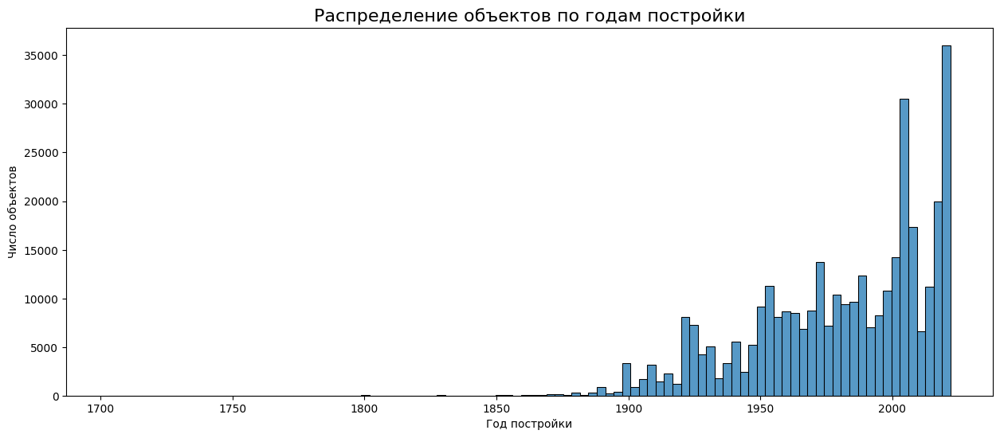

In [111]:
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(15, 6))
plt.subplots_adjust(hspace=.0)

histplot1 = sns.histplot(
    data=data, 
    x='year_built', 
    bins=100,
)
histplot1.set_title('Распределение объектов по годам постройки', fontsize=16)
histplot1.set_xlabel('Год постройки')
histplot1.set_ylabel('Число объектов')

#### Признак 'remodeled_year'

Теперь извлечём из словаря год реконструкции дома и создадим еще один признак remodeled_year.

In [112]:
print("Количество пропусков: ", data['remodeled_year'].isnull().sum())
print("Количество уникальных значений: ", data['remodeled_year'].nunique())
data['remodeled_year'].unique()

Количество пропусков:  26565
Количество уникальных значений:  151


array(['', '1967', '2006', None, '2015', '1997', '2019', '1982', '1905',
       '2009', '2007', '1996', '1995', '1988', '1972', '1949', '1954',
       '1930', '2003', '2000', '1994', '2005', '1983', '1965', '1968',
       '1993', '1999', '2014', '2008', '2010', '2004', '2002', '1984',
       '1952', '1978', '1975', '1947', '1957', '1950', '2012', '1970',
       '2016', '1989', '1998', '1980', '1986', '1973', '1955', '1991',
       '2011', '2017', '1941', '2001', '1990', '1979', '1901', '1918',
       '1977', '1962', '1956', '2013', '1960', '1981', '1969', '1987',
       '1958', '1910', '1925', '1964', '1966', '1992', '1943', '1961',
       '1948', '1931', '1976', '1974', '1935', '1940', '1971', '2018',
       '1916', '1914', '1963', '1985', '1951', '1944', '1942', '1959',
       '1927', '1946', '1945', '1920', '1938', '1936', '0', '1939',
       '1915', '1928', '1923', '1929', '1898', '1899', '1934', '1953',
       '1926', '1937', '1912', '1917', '1906', '1932', '1919', '1921',
       

Столбец содержит 151 уникальное значений и 26.5 тыс пропусков. Проведем обработку этих данных.\
Сделаем допущение, что строка '', '0' и пропуски означают то, что реконструкция дома не проводилась, заменим '' на 0. Пропуски также заполним значением '0'.

In [113]:
data['remodeled_year'] = data['remodeled_year'].apply(lambda x: '0' if x == '' else x)
data['remodeled_year'] = data['remodeled_year'].fillna('0')

data['remodeled_year'].unique()

array(['0', '1967', '2006', '2015', '1997', '2019', '1982', '1905',
       '2009', '2007', '1996', '1995', '1988', '1972', '1949', '1954',
       '1930', '2003', '2000', '1994', '2005', '1983', '1965', '1968',
       '1993', '1999', '2014', '2008', '2010', '2004', '2002', '1984',
       '1952', '1978', '1975', '1947', '1957', '1950', '2012', '1970',
       '2016', '1989', '1998', '1980', '1986', '1973', '1955', '1991',
       '2011', '2017', '1941', '2001', '1990', '1979', '1901', '1918',
       '1977', '1962', '1956', '2013', '1960', '1981', '1969', '1987',
       '1958', '1910', '1925', '1964', '1966', '1992', '1943', '1961',
       '1948', '1931', '1976', '1974', '1935', '1940', '1971', '2018',
       '1916', '1914', '1963', '1985', '1951', '1944', '1942', '1959',
       '1927', '1946', '1945', '1920', '1938', '1936', '1939', '1915',
       '1928', '1923', '1929', '1898', '1899', '1934', '1953', '1926',
       '1937', '1912', '1917', '1906', '1932', '1919', '1921', '1924',
       '1

In [114]:
# Переведем столбец в числовой формат
data['remodeled_year'] = data['remodeled_year'].apply(lambda x: int(x))

Проверим, есть ли случаи, когда дом реконструирован раньше, чем он был построен:

In [115]:
data[(data['remodeled_year'] < data['year_built']) & (data['remodeled_year'] != 0)]

,status,propertyType,street,baths,fireplace,city,schools,sqft,zipcode,beds,...,LAT,LNG,private_pool,year_built,remodeled_year,heating,cooling,parking,lotsize,price/sqft
42,active,single-family,MLS #: STRI1057289,2.5,0,New York,"[{'rating': ['NR', 'NR', '9', '8', '8', '2', '...",NaN,10006,NaN,...,40.709614,-74.012954,0,2010,2003,,,,—,None
94,pre-foreclosed,townhouse,20663 Fm 2154 Rd,4.0,1,College Station,"[{'rating': ['NA', '2/10', 'NA'], 'data': {'Di...","Total interior livable area: 4,179 sqft",77845,4 bd,...,30.561385,-96.272583,0,2016,1984,Other,Central,3 spaces,2 acres,
113,for sale,single-family,3307 Sackett St,5.0,0,Houston,"[{'rating': ['7/10', '10/10', '6/10'], 'data':...","4,410",77098,4,...,29.734813,-95.416098,1,2019,1950,Other,Central,2 spaces,"7,318 sqft",$498
177,active,single-family,10706 Bridge Hollow Ct,2.5,1,Dallas,"[{'rating': ['8', '3', '3', '10'], 'data': {'D...","11,598",75229,NaN,...,32.893295,-96.864339,0,2010,2008,,"Central A/C (Electric), Central Heat (Gas)",,1.24 Acres,$569 / Sq. Ft.
339,for sale,single-family,2499 Decatur St,4.0,0,Denver,"[{'rating': ['5/10', '2/10', '2/10'], 'data': ...","2,335 sqft",80211,3,...,39.767444,-105.019736,0,2015,1960,Forced air,Central,2 spaces,"2,334 sqft",$418
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
376908,for sale,single-family,3715 Linkwood Dr,4.0,0,Houston,"[{'rating': ['5/10', '7/10', '7/10'], 'data': ...","4,169",77025,4,...,29.685706,-95.434764,0,2019,1954,Other,Central,2 spaces,"9,073 sqft",$264
376939,for sale,single-family,1103 NW 25th Ave,2.0,0,Cape Coral,"[{'rating': ['3/10', '8/10', '5/10', '4/10', '...","1,692 sqft",33993,3 Beds,...,26.692897,-82.034065,0,2019,2004,Forced Air,Central,Attached Garage,10018 sqft,$233/sqft
377055,for sale,single-family,120 N Hibiscus Dr,6.0,0,Miami Beach,"[{'rating': ['10/10', '4/10', '5/10'], 'data':...","3,861",33139,5,...,25.779808,-80.153200,1,2015,1949,Forced air,Central,Attached Garage,"9,500 sqft","$1,425"
377111,active,single-family,2889 SW 35th Ave,2.5,0,Miami,"[{'rating': ['7', 'NR', '10', '5', '5'], 'data...",NaN,33133,NaN,...,25.728662,-80.239996,0,1991,1953,,,,0.33 Acres,None


Видим, что у нас в более чем в 4200 строках содержится ошибка: дата реконструкции дома случилась раньше, чем дом был построен. Предполагаю, что это ошибка ввода данных и поля просто перепутали местами. Поэтому предлагается для данных строк сделать перестановку значений этих двух признаков.

In [116]:
# Выделим индексы строк, имеющие данные об ошибках
ind_mist = data[(data['remodeled_year'] < data['year_built']) & (data['remodeled_year'] != 0)].index
ind_mist

Index([    42,     94,    113,    177,    339,    345,    400,    492,    601,
          728,
       ...
       376530, 376672, 376724, 376824, 376846, 376908, 376939, 377055, 377111,
       377145],
      dtype='int64', length=4225)

In [117]:
# У строк с ошибками запишем сведения из remodeled_year в year_built
data.loc[ind_mist, 'year_built'] = data.loc[ind_mist, 'remodeled_year']
# снова проверим на наличие ошибок
data[(data['remodeled_year'] < data['year_built']) & (data['remodeled_year'] != 0)]

,status,propertyType,street,baths,fireplace,city,schools,sqft,zipcode,beds,...,LAT,LNG,private_pool,year_built,remodeled_year,heating,cooling,parking,lotsize,price/sqft


In [118]:
# Посмотрим сколько нулевых значений в столбце
len(data[data['remodeled_year'] == 0])

196534

Количество нулей в столбце 196,5 тысяч, это больше половины всех данных в признаке. Наверное будет целесообразным этот признак перекодировать в бинарный признак, где нули будут означать то, что реконструкция дома не проводилась, а значения годов заменим на '1', что будет означать проведение реконструкции.

In [119]:
# Создаём новый столбец remodeling
data['remodeling'] = data['remodeled_year'].apply(lambda x: 1 if x > 0 else 0)
data.drop('remodeled_year', axis = 1, inplace = True)

data['remodeling'].value_counts()

remodeling
0    196534
1    149119
Name: count, dtype: int64

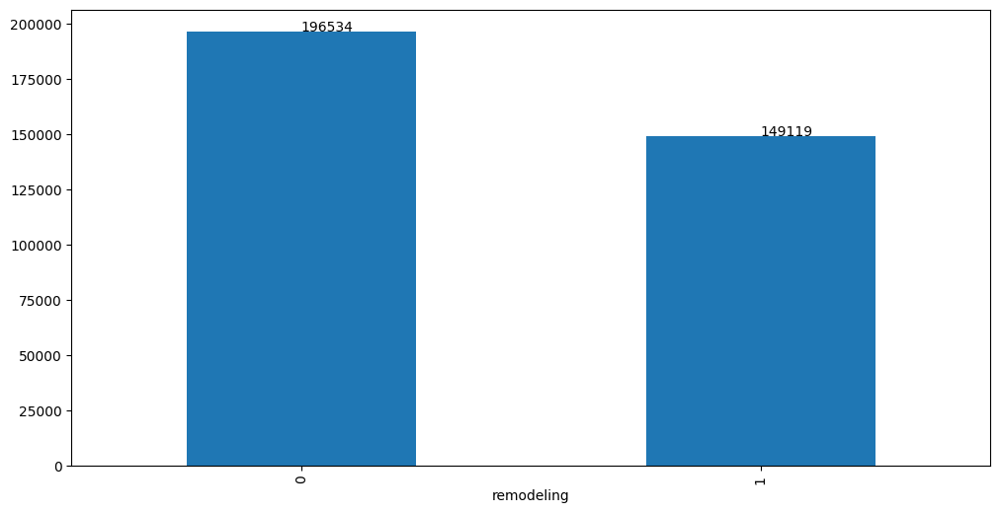

In [120]:
show_plot(data['remodeling'])

#### Признак 'heating'

In [121]:
print("Количество пропусков: ", data['heating'].isnull().sum())
print("Количество уникальных значений: ", data['heating'].nunique())
data['heating'].unique()

Количество пропусков:  3531
Количество уникальных значений:  1982


array(['Central A/C, Heat Pump', '', 'Forced Air', ...,
       'Electric Furnace, Electric Heat Pump',
       'Floor Furnace, Wall Electric, Wall Gas',
       'Baseboard, Hot Water, Programmable Thermostat, Radiant Floor'],
      dtype=object)

В столбце имеется 1982 уникальных записи и 3531 пропусков. Некоторые значения имеют различное написание, но одинаковый смысл. Приведём их к единообразию. Для начала приведём всё к нижнему регистру.

In [122]:
data['heating'] = data['heating'].apply(lambda x: x.lower() if x is not None else x)


In [123]:
data['heating'] = data['heating'].apply(lambda x: np.nan if (x is None) | (x == 'none') | (x == '') else x)
print("Количество пропусков: ", data['heating'].isnull().sum())
print("Количество уникальных значений: ", data['heating'].nunique())
data['heating'].unique()

Количество пропусков:  84791
Количество уникальных значений:  1914


array(['central a/c, heat pump', nan, 'forced air', ...,
       'electric furnace, electric heat pump',
       'floor furnace, wall electric, wall gas',
       'baseboard, hot water, programmable thermostat, radiant floor'],
      dtype=object)

Как оказалось в данных было более 80 тыс записей с пустой строкой - '', которые мы заменили на пустоту, теперь у нас почти 85 тыс пропусков.

In [124]:
data['heating'].value_counts().nlargest(60)

heating
forced air                               133325
other                                     28605
heat pump                                  8776
no data                                    8611
central air                                7812
gas                                        7424
electric                                   7417
central electric                           7112
central                                    6247
central, electric                          4253
baseboard                                  3752
wall                                       3224
electric heat                              3064
heating system                             2707
forced air, heat pump                      1767
radiant                                    1476
central air, ceiling fan(s)                1432
natural gas heat                           1383
central furnace                            1036
forced air, gas                             962
central electric, zoned         

In [125]:
# Заполним пропуски значением 'no data', которое будет означать отсутствие информации об отоплении в доме.
data['heating'] = data['heating'].fillna('no data')

Теперь унифицируем значения признака 

In [126]:
data['heating'] = data['heating'].apply(lambda x: x[2:] if x.startswith(', ') else x)
data['heating'] = data['heating'].apply(lambda x: 'central' if x.startswith('central') else  x)
data['heating'] = data['heating'].apply(lambda x: 'forced air' if x.startswith('forced air') else x)
data['heating'] = data['heating'].apply(lambda x: 'electric' if x.startswith('electric') else x)
data['heating'] = data['heating'].apply(lambda x: x.replace('natural gas', 'gas'))
data['heating'] = data['heating'].apply(lambda x: 'gas' if x.startswith('gas') else x)
data['heating'] = data['heating'].apply(lambda x: 'heat pump' if x.startswith('heat pump') else x)
data['heating'] = data['heating'].apply(lambda x: 'wall' if x.startswith('wall') else x)
data['heating'] = data['heating'].apply(lambda x: 'baseboard' if x.startswith('baseboard') else x)
data['heating'] = data['heating'].apply(lambda x: 'gas' if x.startswith('propane') else x)
data['heating'] = data['heating'].apply(lambda x: 'radiant' if x.startswith('radiant') else x)
data['heating'] = data['heating'].apply(lambda x: 'wall' if x.startswith('wall') else x)


In [127]:
data['heating'].value_counts(normalize=True).nlargest(10).sum()

0.9828729969073031

Первые 10 признаков составляют более 98% объема всего признака, поэтому предлагается остановится на них, а все остальное заменить на other

In [128]:
top_10 = data['heating'].value_counts()[:10].index
data['heating'] = data['heating'].apply(lambda x: x if x in top_10 else 'other')
print("Количество пропусков: ", data['heating'].isnull().sum())
print("Количество уникальных значений: ", data['heating'].nunique())
data['heating'].value_counts()

Количество пропусков:  0
Количество уникальных значений:  10


heating
forced air        139067
no data            93402
other              34525
central            34383
electric           11815
gas                11712
heat pump           9773
baseboard           4503
wall                3766
heating system      2707
Name: count, dtype: int64

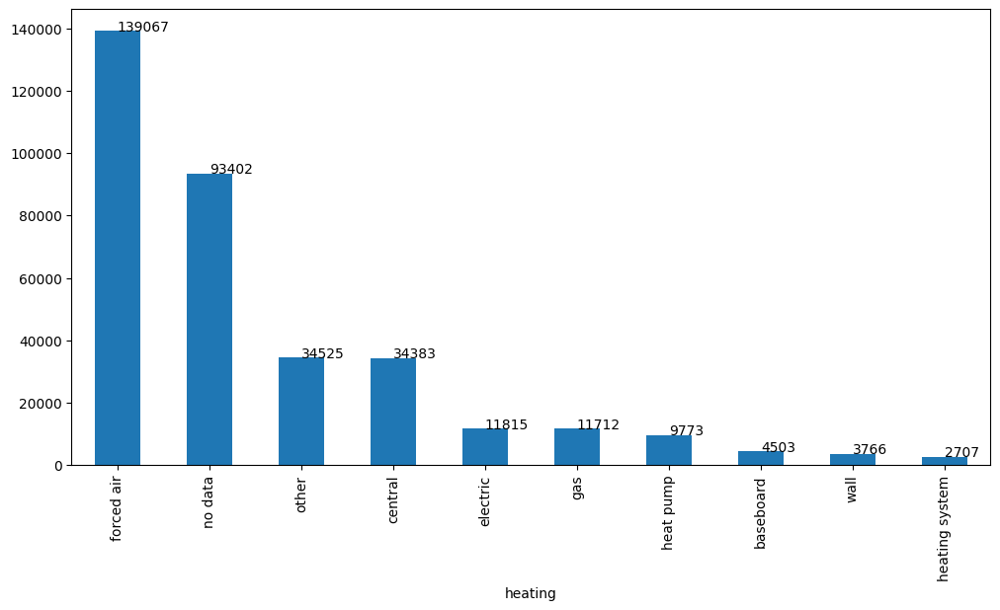

In [129]:
show_plot(data['heating'])

#### Признак 'cooling'

In [130]:
print("Количество пропусков: ", data['cooling'].isnull().sum())
print("Количество уникальных значений: ", data['cooling'].nunique())
data['cooling'].unique()

Количество пропусков:  3531
Количество уникальных значений:  1445


array(['', 'Central', 'Central Air', ...,
       'Central Air, Electric Hot Air, Gas (Hot Air), Heat Pump for A/C, Heat Pump for Heat, Multi-Zone A/C, Multi-Zone Heat, Natural Gas',
       '90%+ High Efficiency, Ductless HP-Mini Split, Tankless Water Heater',
       'Central A/C (Gas), Central Heat (Gas), Heat Pump'], dtype=object)

В столбце имеется 1445 уникальных записи и 3531 пропуско. Преобразуем в читабельный вид. Для начала приведём всё к нижнему регистру.

In [131]:
data['cooling'] = data['cooling'].apply(lambda x: x.lower() if x is not None else x)

In [132]:
data['cooling'] = data['cooling'].apply(lambda x: np.nan if (x is None) | (x == 'none') | (x == '') else x)
print("Количество пропусков: ", data['cooling'].isnull().sum())
print("Количество уникальных значений: ", data['cooling'].nunique())
data['cooling'].unique()

Количество пропусков:  101214
Количество уникальных значений:  1436


array([nan, 'central', 'central air', ...,
       'central air, electric hot air, gas (hot air), heat pump for a/c, heat pump for heat, multi-zone a/c, multi-zone heat, natural gas',
       '90%+ high efficiency, ductless hp-mini split, tankless water heater',
       'central a/c (gas), central heat (gas), heat pump'], dtype=object)

Как оказалось в данных было более 90 тыс записей с пустой строкой - '', которые мы заменили на пустоту, теперь у нас более 101 тыс пропусков.

In [133]:
data['cooling'].value_counts().nlargest(60)

cooling
central                                                        157486
central air                                                     14384
no data                                                         10616
has cooling                                                      9727
central electric                                                 6154
wall                                                             3955
central gas                                                      3573
central heating                                                  2807
cooling system                                                   2699
central a/c                                                      2051
other                                                            1840
central a/c (electric), central heat (gas)                       1646
central a/c (electric), central heat (electric)                  1429
refrigeration                                                    1075
central, ele

In [134]:
# Заполним пропуски значением 'no data', которое будет означать отсутствие информации об охлаждении в доме.
data['cooling'] = data['cooling'].fillna('no data')

Теперь унифицируем значения признака

In [135]:
data['cooling'] = data['cooling'].apply(lambda x: 'central' if x.startswith('central') else  x)
data['cooling'] = data['cooling'].apply(lambda x: 'cooling system' if x.startswith('has cooling') else  x)
data['cooling'] = data['cooling'].apply(lambda x: 'wall' if x.startswith('wall') else  x)
data['cooling'] = data['cooling'].apply(lambda x: 'refrigeration' if x.startswith('refrigeration') else  x)
data['cooling'] = data['cooling'].apply(lambda x: 'electric' if x.startswith('electric') else  x)
data['cooling'] = data['cooling'].apply(lambda x: 'solar' if x.startswith('solar') else  x)
data['cooling'] = data['cooling'].apply(lambda x: 'central' if x.startswith('2 or more units, central, electric') else  x)
data['cooling'] = data['cooling'].apply(lambda x: 'cooling system' if x.startswith('air conditioning unit(s)') else  x)
data['cooling'] = data['cooling'].apply(lambda x: 'ceiling fan' if x.startswith('ceiling fan') else  x)
data['cooling'] = data['cooling'].apply(lambda x: 'central' if x.startswith('cenrtal') else  x)
data['cooling'] = data['cooling'].apply(lambda x: 'cooling system' if x.startswith('multi-zone') else  x)
data['cooling'] = data['cooling'].apply(lambda x: 'central' if x.startswith('air conditioning-central') else  x)

In [136]:
data['cooling'].value_counts(normalize=True).nlargest(10).sum()

0.982039791351442

Первые 10 признаков составляют более 98% объема всего признака, поэтому предлагается остановится на них, а все остальное заменить на other

In [137]:
top_10 = data['cooling'].value_counts()[:10].index
data['cooling'] = data['cooling'].apply(lambda x: x if x in top_10 else 'other')
print("Количество пропусков: ", data['cooling'].isnull().sum())
print("Количество уникальных значений: ", data['cooling'].nunique())
data['cooling'].value_counts()

Количество пропусков:  0
Количество уникальных значений:  10


cooling
central           201952
no data           111830
cooling system     12806
other               8048
wall                4634
refrigeration       2158
electric            1491
ceiling fan         1155
evaporative          997
has heating          582
Name: count, dtype: int64

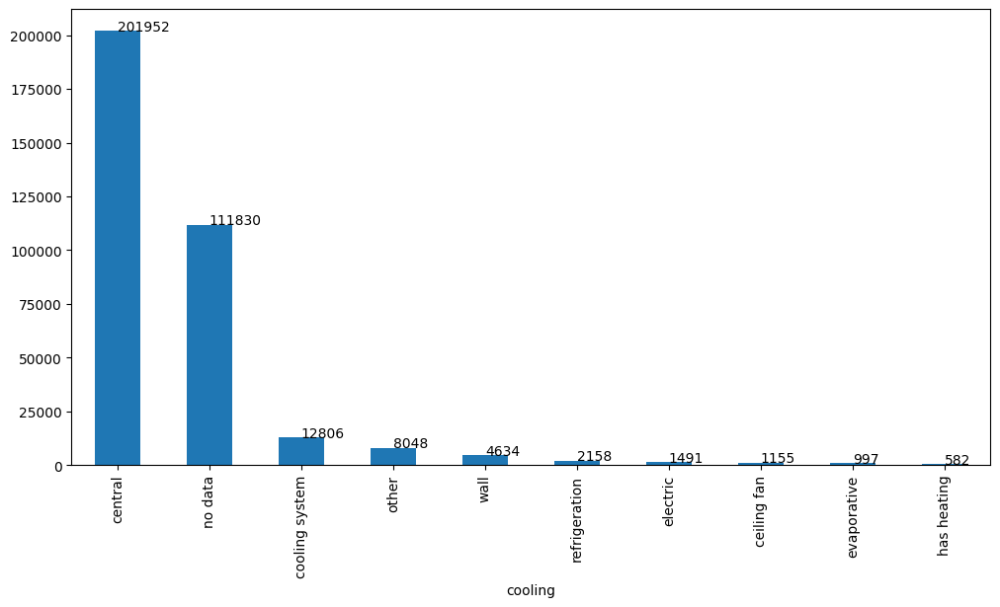

In [138]:
show_plot(data['cooling'])

#### Признак 'parking'

In [139]:
print("Количество пропусков: ", data['parking'].isnull().sum())
print("Количество уникальных значений: ", data['parking'].nunique())
data['parking'].unique()

Количество пропусков:  3531
Количество уникальных значений:  3318


array(['', 'Attached Garage', 'Detached Garage', ...,
       'Basement, Detached',
       'Paved Driveway, Off Street, Detached Garage',
       'Deed Restrictions, Fitness, Gated Community, Golf Carts OK, No Truck/RV/Motorcycle Parking, Pool, Special Community Restrictions'],
      dtype=object)

In [140]:
data['parking'].value_counts().index.tolist()

['',
 'Attached Garage',
 '2 spaces',
 '1 space',
 'No Data',
 'Detached Garage',
 'Carport',
 '3 spaces',
 'Off Street',
 '4 spaces',
 '1',
 '2',
 'Carport, Attached Garage',
 'None',
 'Off street',
 'Attached Garage, Detached Garage',
 'On Street',
 '0',
 'Parking Desc',
 'Attached Garage, Carport',
 '6 spaces',
 'Detached Garage, Attached Garage',
 'Driveway',
 '5 spaces',
 '4',
 'On street',
 'Parking Type',
 'Off Street, Attached Garage',
 '3',
 'Off street parking',
 'Carport, Detached Garage',
 'Attached Garage, Garage - 2 Car',
 'Garage Type',
 'Parking YN',
 'Driveway, Garage Door Opener',
 'Garage - 2 Car',
 'Garage Door Opener',
 '888',
 'Attached Garage, Off Street',
 'Attached - FRONT',
 'Slab Parking Spaces',
 '8 spaces',
 'Off Street, On Street',
 'Detached Garage, Carport',
 '6',
 'Off Street, Detached Garage',
 'Garage-Attached',
 'Electric Door Opener',
 'Attached - SIDE',
 'Attached',
 'On Street, Off Street',
 '7 spaces',
 'Carport Spaces',
 'Electric Door Opener, S

В столбце имеется 3318 уникальных записи и 3531 пропуск. Преобразуем информацию в признаке в читабельный вид.

In [141]:
data['parking'] = data['parking'].apply(lambda x: x.lower() if x is not None else x)
data['parking'] = data['parking'].apply(lambda x: np.nan if (x is None) | (x == '') | (x == '0') else x)

In [142]:
print("Количество пропусков: ", data['parking'].isnull().sum())

Количество пропусков:  146921


Оказывается пропусков сильно больше - почти 147 тысяч. Заменим из на 'no data', которое будет означать отсутствие информации о паркинге

In [143]:
data['parking'] = data['parking'].fillna('no data')
data['parking'].value_counts()[:50]

parking
no data                                      160253
attached garage                               70112
2 spaces                                      28062
1 space                                       14252
detached garage                               12923
carport                                        7569
off street                                     5243
3 spaces                                       4724
4 spaces                                       2917
1                                              2902
2                                              2726
carport, attached garage                       2700
none                                           2326
on street                                      1696
attached garage, detached garage               1304
parking desc                                    900
attached garage, carport                        859
6 spaces                                        755
detached garage, attached garage                705
driv

In [144]:
data['parking'] = data['parking'].apply(lambda x: 'off street' if x.startswith('off street') else  x)
data['parking'] = data['parking'].apply(lambda x: 'off street' if x.startswith('2 off street') else  x)
data['parking'] = data['parking'].apply(lambda x: 'attached garage' if x.startswith('attached') else  x)
data['parking'] = data['parking'].apply(lambda x: 'attached garage' if x.startswith('attch') else  x)
data['parking'] = data['parking'].apply(lambda x: 'detached garage' if x.startswith('detached') else  x)
data['parking'] = data['parking'].apply(lambda x: 'carport' if x.startswith('carport') else  x)
data['parking'] = data['parking'].apply(lambda x: 'garage' if x.startswith('garage') else  x)
data['parking'] = data['parking'].apply(lambda x: 'garage' if x.startswith('888') else  x)
data['parking'] = data['parking'].apply(lambda x: 'on street' if x.startswith('driveway') else  x)
data['parking'] = data['parking'].apply(lambda x: 'on street' if x.startswith('on street') else  x)
data['parking'] = data['parking'].apply(lambda x: '2 spaces' if x.startswith('2 car garage') else  x)
data['parking'] = data['parking'].apply(lambda x: 'parking' if x.startswith('parking') else  x)
data['parking'] = data['parking'].apply(lambda x: 'parking' if x.startswith('slab parking spaces') else  x)
data['parking'] = data['parking'].apply(lambda x: '2 spaces' if x == '2' else  x)
data['parking'] = data['parking'].apply(lambda x: '1 space' if x == '1' else  x)
data['parking'] = data['parking'].apply(lambda x: '3 spaces' if x == '3' else  x)
data['parking'] = data['parking'].apply(lambda x: '4 spaces' if x == '4' else  x)
data['parking'] = data['parking'].apply(lambda x: '5 spaces' if x == '5' else  x)
data['parking'] = data['parking'].apply(lambda x: '6 spaces' if x == '6' else  x)
data['parking'] = data['parking'].apply(lambda x: '7 spaces' if x == '7' else  x)
data['parking'] = data['parking'].apply(lambda x: '8 spaces' if x == '8' else  x)
data['parking'] = data['parking'].apply(lambda x: '9 spaces' if x == '9' else  x)
data['parking'] = data['parking'].apply(lambda x: '10 spaces' if x == '10' else  x)
data['parking'] = data['parking'].apply(lambda x: '11 spaces' if x == '11' else  x)
data['parking'] = data['parking'].apply(lambda x: '12 spaces' if x == '12' else  x)

data['parking'] = data['parking'].apply(lambda x: '5+ spaces' if (x == '5 spaces') | (x == '6 spaces') | (x == '7 spaces')
                                         | (x == '8 spaces') | (x == '9 spaces') | (x == '10 spaces') | (x == '11 spaces')
                                          | (x == '12 spaces') else  x)

print(data['parking'].value_counts(normalize=True).nlargest(14).sum())
data['parking'].value_counts()[:20]

0.9849415454227215


parking
no data                                                            160253
attached garage                                                     76076
2 spaces                                                            31267
1 space                                                             17154
detached garage                                                     14377
carport                                                             11386
off street                                                           7485
3 spaces                                                             5162
on street                                                            4027
4 spaces                                                             3513
parking                                                              2601
5+ spaces                                                            2558
none                                                                 2326
garage                        

In [145]:
# Выделим топ 14 категорий, т.к. они составляют 98% всего признака, остальные обозначим 'other'
top_14 = data['parking'].value_counts()[:14].index
data['parking'] = data['parking'].apply(lambda x: x if x in top_14 else 'other')
print("Количество пропусков: ", data['parking'].isnull().sum())
print("Количество уникальных значений: ", data['parking'].nunique())
data['parking'].value_counts()

Количество пропусков:  0
Количество уникальных значений:  15


parking
no data            160253
attached garage     76076
2 spaces            31267
1 space             17154
detached garage     14377
carport             11386
off street           7485
other                5205
3 spaces             5162
on street            4027
4 spaces             3513
parking              2601
5+ spaces            2558
none                 2326
garage               2263
Name: count, dtype: int64

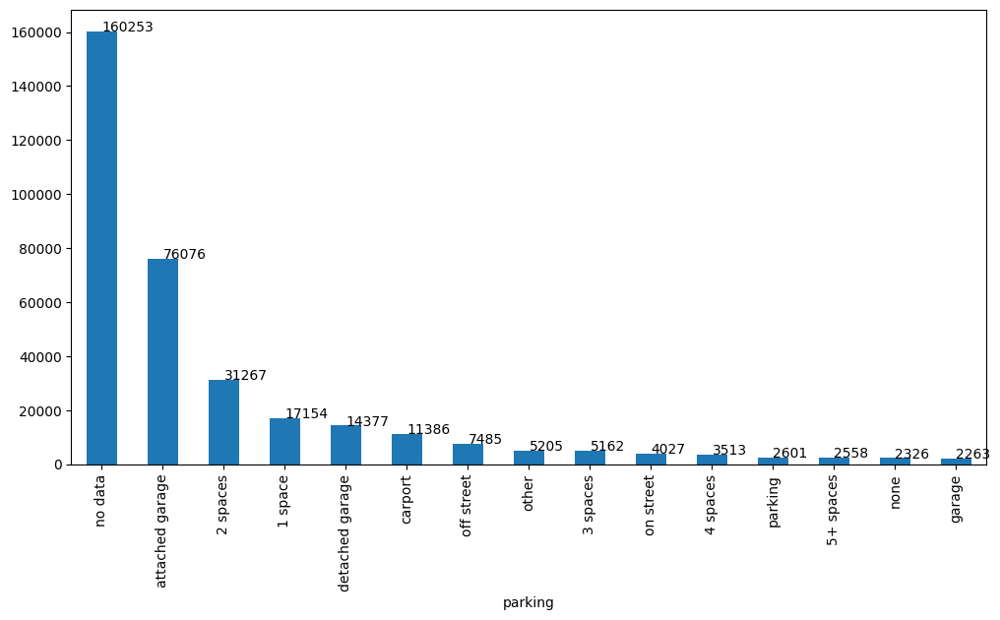

In [146]:
show_plot(data['parking'])

#### Признак 'lotsize'

In [147]:
print("Количество пропусков: ", data['lotsize'].isnull().sum())
print("Количество уникальных значений: ", data['lotsize'].nunique())
data['lotsize'].value_counts()[:50]

Количество пропусков:  28221
Количество уникальных значений:  34197


lotsize
                  32475
—                 25237
No Data            5328
-- sqft lot        3819
0.26 acres         2181
0.28 acres         1845
0.25 acres         1811
0.27 acres         1742
0.29 acres         1652
6,098 sqft         1514
0.34 acres         1417
0.3 acres          1352
7,405 sqft         1345
6,534 sqft         1279
4,356 sqft         1249
0.31 acres         1172
5,227 sqft         1150
10,000 sqft        1148
0.32 acres         1111
5,000 sqft         1093
8,712 sqft         1002
0.33 acres          975
3,920 sqft          972
8,276 sqft          957
0.35 acres          956
0.36 acres          857
0.37 acres          820
0.46 acres          812
4,792 sqft          741
9,583 sqft          732
4,791 sqft          716
0.4 acres           713
0.38 acres          708
1 acre              692
0.39 acres          681
7,840 sqft          657
2,500 sqft          653
6,969 sqft          652
10,454 sqft         650
0.41 acres          631
3,049 sqft          629
0.26 Acr

В признаке присутствует 34197 уникальных значения и 28220 пропусков. Также будем считать пропусками значения '—', 'No Data' и '-- sqft lot'. Видим, что значения записаны в разных единицах измерения - акры(acres) и квадратные фунты(sqft). Приведем все к единому виду, запятые уберем.

In [148]:
# 1 acre = 43560 sqft

def change_acr(acr):
    """ Переводит акры в квадратные фунты

    Args:
        acr (str): значение в акрах

    Returns:
        float: значение в квадратных фунтах
    """
    sqft = 43560 * float(acr)
    return sqft

def lotsize_handler(df):
    """ Обработчик признака lotsize

    Args:
        df (Series): необработанный признак

    Returns:
        float/str: обработанный признак
    """
    
    # заменяем пропуски на No и приводим разделитель к общему виду
    df = df.replace('—', 'No').replace('No Data', 'No').replace('-- sqft lot', 'No').replace(',', '')
    
    if df != 'No':
        # приводим строку к нижнему регистру
        df = df.lower()
        # создаём лист со значениями 
        list_temp = df.split(' ')
        # если строка состоит из более чем одного значения, и второе значение 'acres' или 'acre', то переводим в кв фунты
        if (len(list_temp) > 1) and (df.split(' ')[1] == 'acres' or df.split(' ')[1] == 'acre'):
            df = change_acr(list_temp[0])
            return df
        else:
            df = float(list_temp[0])
            return df
    return df

In [149]:
# меняем пропущенные значения на No
data['lotsize'] = data['lotsize'].apply(lambda x: 'No' if (x is np.nan) | (x is None) | (x == '') else x)
# применяем функцию lotsize_handler
data['lotsize'] = data['lotsize'].apply(lotsize_handler)
# все No меняем на np.nan, отрицательные значения на 0
data['lotsize'] = data['lotsize'].apply(lambda x: np.nan if x == 'No' else 0 if x < 0 else x)

In [150]:
print("Количество пропусков: ", data['lotsize'].isnull().sum())

Количество пропусков:  95080


Пропусков много, предлагается заменить их на медианное значение в зависимости от типа жилья, а чтобы модель понимала, что данные смоделированные сделаем дополнительный признак 'lotsize_was_null'

In [151]:
data['lotsize'] = data['lotsize'].fillna('0')
# создаем новый признак и заполняем его единицами, если в основном признаке у нас  пропуски/нули
data['lotsize_was_null'] = data['lotsize'].apply(lambda x: 1 if x == '0' else 0)
# Проверяем сколько строк у нас помечено
data['lotsize_was_null'].sum()

95080

In [152]:
# Теперь заменяем пропуски на медианное значение в зависимости от типа жилья
data['lotsize'] = data['lotsize'].apply(lambda x: np.nan if x == '0' else x)
for prop_type in data['propertyType'].value_counts().index:
    mask = data['propertyType'] == prop_type
    if data[mask].isnull().sum()['lotsize'] > 0:
        value = {'lotsize': data[mask]['lotsize'].median()}
        data[mask] = data[mask].fillna(value)
    
print("Количество пропусков: ", data['lotsize'].isnull().sum())
print("Количество уникальных значений: ", data['lotsize'].nunique())
data['lotsize'].describe()

Количество пропусков:  0
Количество уникальных значений:  16416


count    3.456530e+05
mean     7.121081e+04
std      5.438488e+06
min      0.000000e+00
25%      4.235000e+03
50%      7.840000e+03
75%      1.034100e+04
max      2.147484e+09
Name: lotsize, dtype: float64

In [153]:
# Проверим слишком большие значения, более 92 гектар (1е7 кв.футов)
data[data['lotsize'] > 1e7]

,status,propertyType,street,baths,fireplace,city,schools,sqft,zipcode,beds,...,LNG,private_pool,year_built,heating,cooling,parking,lotsize,price/sqft,remodeling,lotsize_was_null
1381,for sale,single-family,6019 N Ella St,4.0,1,Spokane,"[{'rating': ['6/10', '4/10', '8/10'], 'data': ...","4,820",99217,5,...,-117.261376,0,2006,heat pump,central,5+ spaces,2.147484e+09,$166,1,0
3285,pre-foreclosed,townhouse,3553 Queen Anne Way,3.0,0,Colorado Springs,"[{'rating': ['5/10', '4/10', '2/10'], 'data': ...",NaN,80917,2 bd,...,-104.745264,0,1983,forced air,no data,no data,2.779128e+07,,0,0
5527,for sale,townhouse,1811 S Quebec Way APT 173,3.0,0,Denver,"[{'rating': ['4/10', '6/10', '4/10'], 'data': ...","1,131 sqft",80231,2,...,-104.887802,0,1983,forced air,central,1 space,2.770416e+07,$234,0,0
14141,pre-foreclosed,single-family,1443 Acacia Dr,2.0,1,Colorado Springs,"[{'rating': ['6/10', '4/10', '6/10'], 'data': ...","Total interior livable area: 1,400 sqft",80907,3 bd,...,-104.827015,0,1963,forced air,other,off street,4.138200e+08,,0,0
20985,for sale,townhouse,8921 NE 4th Avenue Rd # 8921,2.0,0,Miami Shores,"[{'rating': ['10/10', '2/10'], 'data': {'Dista...",954,33138,2,...,-80.178006,1,1974,other,central,off street,4.155624e+07,$207,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
363618,pre-foreclosed,single-family,Pioneer Rd,2.5,0,St george,"[{'rating': ['7/10', '8/10', '8/10'], 'data': ...",NaN,84790,-- bd,...,-113.577299,0,2011,no data,no data,no data,2.694142e+07,,0,0
366919,for sale,single-family,505 Tennessee St,1.0,0,Memphis,"[{'rating': ['3/10', '3/10'], 'data': {'Distan...","1,780",38103,1,...,-90.054979,0,1909,no data,central,attached garage,3.794947e+07,$115,0,0
367944,for sale,single-family,4301 NW 7th St,2.5,0,Miami,"[{'rating': ['5/10', '6/10', '3/10', '10/10', ...",NaN,33126,NaN,...,-80.299475,0,1947,no data,no data,2 spaces,3.811500e+07,None,0,0
369653,for sale,single-family,709 26th Ave N #B,4.0,0,Nashville,"[{'rating': ['2/10', '3/10', '2/10'], 'data': ...","1,960 sqft",37208,4 Beds,...,-86.808023,0,2018,no data,no data,no data,3.794947e+07,$408/sqft,0,0


Удалим их, скорее всего это выборосы

In [154]:
data.drop(data[data['lotsize'] > 1e7].index, inplace=True)

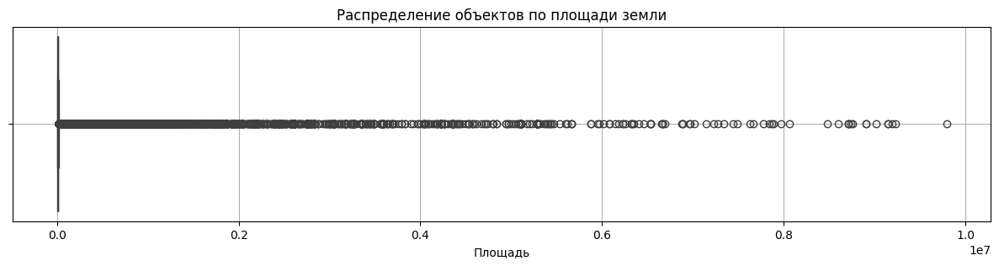

In [155]:
fig = plt.figure(figsize=(15, 3))
boxplot = sns.boxplot(
    data=data,
    x='lotsize',
    orient='h',
    width=0.9
)
boxplot.set_title('Распределение объектов по площади земли');
boxplot.set_xlabel('Площадь');
boxplot.grid()

#### Признак 'price/sqft'

In [156]:
data_copy = data.copy()

Выборочный анлиз данных вручную показал, что данный признак прямо пропорционален нашему целевому признаку. Поэтому во избежании утечки данных его необходимо удалить. Но пока предлагаю его оставить, чтобы он был нашим "помощником" при заполнении пустых значений в признаках 'sqft' или 'target', при необходимости.

In [157]:
data['price/sqft'].unique().tolist()

['$144',
 '$159/sqft',
 '$965/sqft',
 '$371/sqft',
 '$233/sqft',
 '$120 / Sq. Ft.',
 '$57 / Sq. Ft.',
 '$68',
 '$162',
 '$515/sqft',
 '$83 / Sq. Ft.',
 '$185/sqft',
 '$275',
 '$69',
 None,
 '$152 / Sq. Ft.',
 '$797 / Sq. Ft.',
 '$119/sqft',
 '$388/sqft',
 '$217',
 '$665',
 '$536 / Sq. Ft.',
 '$137/sqft',
 '$93/sqft',
 '$647/sqft',
 '$194/sqft',
 '$238/sqft',
 '$888/sqft',
 '$688',
 '$156',
 '$174/sqft',
 '$165',
 '$122/sqft',
 '$289/sqft',
 '$197',
 '$355',
 '$96',
 '$224/sqft',
 '$260/sqft',
 '$116/sqft',
 '$453',
 '$267',
 '$139/sqft',
 '$498/sqft',
 '$950',
 '$257/sqft',
 '$107/sqft',
 '$642',
 'No Info',
 '$154/sqft',
 '$213/sqft',
 '$163/sqft',
 '$152',
 '$115',
 '$136/sqft',
 '$340/sqft',
 '$205/sqft',
 '$118',
 '$617/sqft',
 '$190 / Sq. Ft.',
 '$454/sqft',
 '$300',
 '$81',
 '$397/sqft',
 '$271/sqft',
 '$865/sqft',
 '$1208 / Sq. Ft.',
 '$168',
 '$145',
 '$147',
 '$132/sqft',
 '$155/sqft',
 '$102/sqft',
 '$196/sqft',
 '$115/sqft',
 '$373/sqft',
 '$139',
 '$119',
 '$208 / Sq. Ft.',

In [158]:
data['price/sqft'] = data['price/sqft'].apply(lambda x: x.lower() if x is not None else x)

old = ['$', ' / sq. ft.', ',', '/sqft', 'no data', 'no info', 'none', 'contact manager']

for i in range(len(old)):
    data['price/sqft'] = data['price/sqft'].apply(lambda x: x.replace(old[i], '') if x is not None else x)
    
data['price/sqft'] = data['price/sqft'].apply(lambda x: np.nan if (x == '') | (x is None) else x)

In [159]:
data['price/sqft'] = data['price/sqft'].apply(lambda x: float(x))

In [160]:
print("Количество пропусков: ", data['price/sqft'].isnull().sum())
print("Количество уникальных значений: ", data['price/sqft'].nunique())
data['price/sqft'].describe()

Количество пропусков:  38414
Количество уникальных значений:  2953


count    3.071020e+05
mean     4.182747e+02
std      1.909957e+04
min      0.000000e+00
25%      1.230000e+02
50%      1.780000e+02
75%      3.000000e+02
max      5.000000e+06
Name: price/sqft, dtype: float64

In [161]:
# заполним все пропуски 0
data['price/sqft'] = data['price/sqft'].fillna(0)

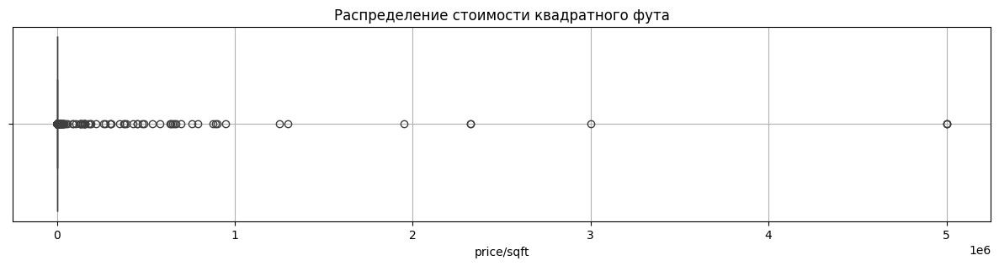

In [162]:
fig = plt.figure(figsize=(15, 3))
boxplot = sns.boxplot(
    data=data,
    x='price/sqft',
    orient='h',
    width=0.9
)
boxplot.set_title('Распределение стоимости квадратного фута');
boxplot.set_xlabel('price/sqft');
boxplot.grid()

Выбросы этого признака проверим позднее в совокупности с другими признаками

### Целевой признак 'target' (1й подход)

In [163]:
print("Количество пропусков: ", data['target'].isnull().sum())
print("Количество уникальных значений: ", data['target'].nunique())
data['target'].unique().tolist()

Количество пропусков:  2459
Количество уникальных значений:  42762


['$418,000',
 '$310,000',
 '$2,895,000',
 '$2,395,000',
 '$209,000',
 '181,500',
 '68,000',
 '$244,900',
 '$311,995',
 '$669,000',
 '260,000',
 '$525,000',
 '$499,900',
 '$168,800',
 '1,650,000',
 '335,000',
 '2,650,000',
 '$365,000',
 '$626,000',
 '$375,000',
 '$3,500,000',
 '579,000',
 '$499,007',
 '$182,000',
 '$3,749,000',
 '799,000',
 '$559,000',
 '$830,000',
 '$1,195,000',
 '$262,000',
 '$204,800',
 '$179,000',
 '$105,000',
 '$260,000',
 '$284,900',
 '$495,000',
 '$117,900',
 '$385,000',
 '54,000',
 '850,000',
 '$620,000',
 '$125,000',
 '$499,000',
 '$1,429,000',
 '$233,990+',
 '125,000',
 '$598,000',
 '$1,780,000',
 '$490,000',
 '$175,000',
 '$2,785,000',
 '$166,500',
 '$259,658',
 '$799,000',
 '$244,990',
 '$333,543',
 nan,
 '$409,069',
 '50,000',
 '$149,999',
 '$220,000',
 '$749,000',
 '$255,000',
 '$269,000',
 '$475,000',
 '219,900',
 '$1,785,000',
 '$714,550',
 '$414,900',
 '$1,795,000',
 '$339,000',
 '$916,900',
 '650,000',
 '$399,000',
 '$289,000',
 '$344,990',
 '$299,999'

In [164]:
data['target'] = data['target'] \
.str.replace(',', '') \
.str.replace('$', '') \
.str.replace('+', '') \
.str.replace('/mo', '') \
.str.replace('1215 - 1437', '1215')  

# заполним все пропуски 0
data['target'] = data['target'].fillna(0)
data['target'] = data['target'].apply(lambda x: float(x))       

### Признак 'sqft'

In [165]:
print("Количество пропусков: ", data['sqft'].isnull().sum())
print("Количество уникальных значений: ", data['sqft'].nunique())
data['sqft'].unique()

Количество пропусков:  24083
Количество уникальных значений:  24929


array(['2900', '1,947 sqft', '3,000 sqft', ..., '4371', '13,870 sqft',
       'Total interior livable area: 4,615 sqft'], dtype=object)

В столбце 24930 уникальных значений и 24 тыс пропусков. Значения признака имеют разный формат записи: '1,200 sqft', '--', '-- sqft', а также несколько значенией в виде: 'Total interior livable area: 4,615 sqft'. Унифицируем значения, избавившись от букв и лишних символов. После преобразуем признак в числовой и заполним пропуски.

In [166]:
data['sqft'] = data['sqft'] \
.str.replace('Total interior livable area: ','') \
.str.replace(',', '') \
.str.replace(' sqft', '') \
.str.replace('610-840', '840')    

data['sqft'] = data['sqft'].apply(lambda x: np.nan if (x == '0') | (x == '') | (x is None) | (x == '--') else x)

In [167]:
# заполним все пропуски 0
data['sqft'] = data['sqft'].fillna('0')

In [168]:
# переводим в числовой формат
data['sqft'] = data['sqft'].apply(lambda x: float(x))

#### Заполнение пропусков в признаках 'sqft' и 'target' через расчет с признаком 'price/sqft'

In [169]:
print('Число пустых значений площади жилья: ', data[data['sqft'] == 0].shape[0])
print('Из них мы можем рассчитать и заполнить: ', data[(data['sqft'] == 0) & (data['target'] != 0) & (data['price/sqft'] != 0)].shape[0])


Число пустых значений площади жилья:  25835
Из них мы можем рассчитать и заполнить:  1255


In [170]:
print('Число пустых значений целевого признака: ', data[data['target'] == 0].shape[0])
print('Из них мы можем рассчитать и заполнить: ', data[(data['target'] == 0) & (data['sqft'] != 0) & (data['price/sqft'] != 0)].shape[0])

Число пустых значений целевого признака:  2459
Из них мы можем рассчитать и заполнить:  349


Заполним 0-вые значения признака 'sqft' (это наши пропуски, их у нас почти 26 тыс.) через расчет значения путем деления стоимости объекта (target) на цену за кв.фут (price/sqft) - таким образом заполним хотя бы 1255 пропусков. Сделаем это в дополнительном признаке 'add_sqft'

In [171]:
data['add_sqft'] = data[(data['sqft'] == 0) & (data['target'] != 0) & (data['price/sqft'] != 0)].apply(
    lambda x: round(x['target']/x['price/sqft'], 2), axis = 1)

# заполним все пропуски 0
data['add_sqft'] = data['add_sqft'].fillna(0)

# Теперь сложим признаки 'sqft' и 'add_sqft':
data['sqft'] = data['sqft'] + data['add_sqft']

# удалим вспомогательный признак
data.drop(['add_sqft'], axis = 1, inplace = True)

# Что получилось в итоге:
print('Число пустых значений площади жилья: ', data[data['sqft'] == 0].shape[0])
print('Из них мы можем рассчитать и заполнить: ', data[(data['sqft'] == 0) & (data['target'] != 0) & (data['price/sqft'] != 0)].shape[0])

Число пустых значений площади жилья:  24580
Из них мы можем рассчитать и заполнить:  0


 Аналогичным образом заполняем 349 пустых значений для признака target:

In [172]:
data['add_target'] = data[(data['target'] == 0) & (data['sqft'] != 0) & (data['price/sqft'] != 0)].apply(
    lambda x: round(x['sqft'] * x['price/sqft'], 2), axis = 1)

# заполним все пропуски 0
data['add_target'] = data['add_target'].fillna(0)

# Теперь сложим признаки 'target' и 'add_target':
data['target'] = data['target'] + data['add_target']

# удалим вспомогательный признак
data.drop(['add_target'], axis = 1, inplace = True)

# Что получилось в итоге:
print('Число пустых значений целевого признака: ', data[data['target'] == 0].shape[0])
print('Из них мы можем рассчитать и заполнить: ', data[(data['target'] == 0) & (data['sqft'] != 0) & (data['price/sqft'] != 0)].shape[0])

Число пустых значений целевого признака:  2110
Из них мы можем рассчитать и заполнить:  0


Вот теперь мы извлекли пользу из признака price/sqft и можем удалить его за ненадобностью:

In [173]:
data.drop(['price/sqft'], axis = 1, inplace = True)

#### Возвращаемся к признаку 'sqft'

In [174]:
data[data['sqft'] != 0]['sqft'].describe()

count    3.209360e+05
mean     6.668956e+03
std      1.619873e+06
min      1.000000e+00
25%      1.300000e+03
50%      1.840000e+03
75%      2.621000e+03
max      7.959794e+08
Name: sqft, dtype: float64

Признак sqft имеет большой разброс. Стандартное отклонение 1619873 квадратных футов. Минимальное значение 1, а максимальное почти 795979400 квадратных футов. При этом медиана равна 1840.

In [175]:
# посмотрим на значения свыше 1 млн кв. футов
data[data['sqft'] > 1e6]

,status,propertyType,street,baths,fireplace,city,schools,sqft,zipcode,beds,...,LAT,LNG,private_pool,year_built,heating,cooling,parking,lotsize,remodeling,lotsize_was_null
62735,for sale,single-family,1723 Pulte St,2.00,1,Cincinnati,"[{'rating': ['4/10', '2/10', '1/10', '2/10', '...",795979430.0,45225,2 Beds,...,39.142809,-84.551212,0,1901,forced air,wall,attached garage,2874.0,0,0
173318,for sale,single-family,18615 Senior Rd,2.50,0,Von Ormy,"[{'rating': ['4/10'], 'data': {'Distance': ['2...",1916640.0,78073,NaN,...,29.243915,-98.622442,0,2019,no data,no data,no data,1916640.0,0,0
253736,active,single-family,23114 Hennes Pass,2.25,0,San Antonio,"[{'rating': ['10', '6', '7'], 'data': {'Distan...",2585006.0,78255,Baths,...,29.651922,-98.656362,0,2012,no data,no data,no data,25700.4,0,0
354878,active,single-family,23106 Casey Cyn,2.25,0,San Antonio,"[{'rating': ['10', '6', '7'], 'data': {'Distan...",2807917.0,78255,Baths,...,29.651922,-98.656362,0,2012,no data,no data,no data,27878.4,0,0
376523,active,multi-family,5382 S Dixie Hwy,3.00,0,Glendale,"[{'rating': ['5', '7', '7', 'NR', 'NR', 'NR'],...",456602479.0,42740,NaN,...,37.586367,-85.948754,0,2012,electric,central,no data,456509.0,0,0


Тут явно какие то ошибки, поэтому предлагается такие объекты удалить.

**Площадь жилья это очень важная характеристика объекта недвижимости, которая прямо пропорциональна его стоимости, поэтому выдумывать что-то вместо ошибочных данных будет неправильно!**

In [176]:
data.drop(data[data['sqft'] > 1e6].index, inplace=True)

In [177]:
data[data['sqft'] != 0]['sqft'].describe()

count    320931.000000
mean       2743.320962
std       13059.199634
min           1.000000
25%        1300.000000
50%        1840.000000
75%        2621.000000
max      967300.000000
Name: sqft, dtype: float64

Теперь посмотрим на "выдающиеся значения снизу". Возьмем за порог 100 кв.футов или по-русски немногим больше 9 кв.м. - т.е. просто все жилье представляет из себя очень маленькую комнату. Все что меньше посчитаем ошибочным.

In [178]:
print(data[(data['sqft'] < 100) & data['sqft'] != 0]['sqft'].count())
data[(data['sqft'] < 100) & data['sqft'] != 0]['sqft'].value_counts()

95


sqft
1.0     51
2.0      7
30.0     3
40.0     3
57.0     2
5.0      2
10.0     2
72.0     2
80.0     2
3.0      2
68.0     2
96.0     1
46.0     1
22.0     1
20.0     1
45.0     1
4.0      1
84.0     1
66.0     1
33.0     1
12.0     1
48.0     1
6.0      1
35.0     1
60.0     1
64.0     1
90.0     1
31.0     1
Name: count, dtype: int64

Видим, что у нас в датасете есть 95 объектов с площадью меньше 100 кв.футов, причем 51 из них имеют площадь 1 кв.фут

In [179]:
data[data['sqft'] == 1]['target'].describe()

count    5.100000e+01
mean     7.811050e+05
std      1.191876e+06
min      0.000000e+00
25%      1.571250e+05
50%      4.290000e+05
75%      7.745000e+05
max      5.000000e+06
Name: target, dtype: float64

Причем стоимость таких объектов колеблется от 0 до почти 5 миллионов!!!\
Предлагается также удалить эти объекты

In [180]:
data.drop(data[(data['sqft'] < 100) & (data['sqft'] != 0)].index, inplace=True)

In [181]:
# Проверим сколько у нас осталось пустых значений
print('Количество пустых значений признака площади жилья составляет: ', data[data['sqft'] == 0].shape[0])
print('что составляет от всего признака: ', round(data[data['sqft'] == 0].shape[0] / data.shape[0] * 100, 2), '%')

Количество пустых значений признака площади жилья составляет:  24580
что составляет от всего признака:  7.12 %


Несмотря на все преобразования в признаке осталось более 24 тысяч пропусков. Повторюсь, что **площадь жилья это очень важная характеристика объекта недвижимости, которая прямо пропорциональна его стоимости, поэтому заполнять пропуски выдумывая для их заполнения какие-то медианные, средние и т.п. значения будет неверно!**\
Принимаю решение оставить в пропусках нули и сделать очистку признака по методу Тьюки

In [182]:
def outliers_iqr(data, feature, left, right):
    """ Избавим признак от выбросов по методу Тьюки

    Args:
        data (DateFrame): датафрейм
        feature (Series): признак в датафрейме для обработки

    Returns:
        DateFrame: возвращает два датафрейма - outliers с выбросами и cleaned очищенный датасет
    """
    x = data[feature]
    quartile_1, quartile_3 = x.quantile(0.25), x.quantile(0.75),
    iqr = quartile_3 - quartile_1
    lower_bound = quartile_1 - (iqr * left)
    upper_bound = quartile_3 + (iqr * right)
    outliers = data[(x<lower_bound) | (x > upper_bound)]
    cleaned = data[(x>lower_bound) & (x < upper_bound)].reset_index()
    cleaned = cleaned.drop([feature, 'index'], axis=1)
    return outliers, cleaned

In [183]:
# Очистка sqft от выбросов по методу Тьюки. Разброс влево сделаем, пошире, чтобы не сильно убивать малоразмерное жилье
# Перед этим прологарифмируем наш признак
data['sqft_log'] = np.log(data['sqft'])
outliers, data = outliers_iqr(data, 'sqft_log', 3, 1.5)

In [184]:
print(f'Число выбросов по методу Тьюки: {outliers.shape[0]}')
print(f'Результирующее число записей: {data.shape[0]}')

Число выбросов по методу Тьюки: 28767
Результирующее число записей: 316649


In [185]:
# Построение гистограммы на очищенных от выбросов данных
fig = px.histogram(
    data_frame=data,
    x='sqft',    
    title='Распределение объектов по площади помещения',
    text_auto=True,    
    height=700,    
    width=1200,
    marginal='box'     
)
fig.show()

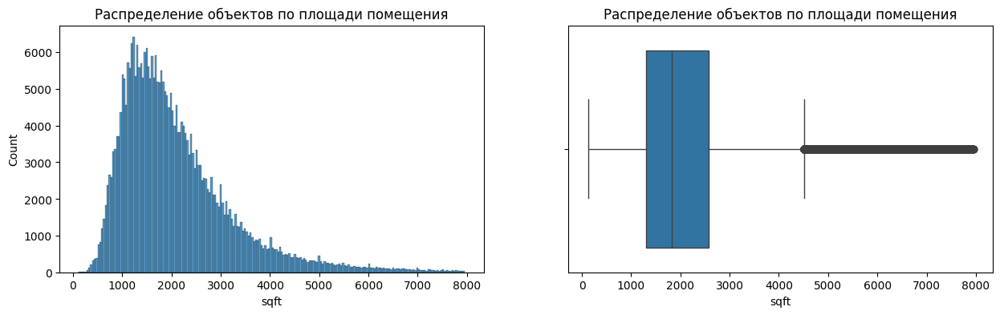

In [186]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 4))
histplot = sns.histplot(data=data, x='sqft', ax=axes[0]);
histplot.set_title('Распределение объектов по площади помещения');
boxplot = sns.boxplot(data=data, x='sqft', ax=axes[1]);
boxplot.set_title('Распределение объектов по площади помещения');

### Признак 'schools'

In [187]:
data['schools'].value_counts()

schools
[{'rating': [], 'data': {'Distance': [], 'Grades': []}, 'name': []}]                                                                                                                                                                                                                                                                                                                                                        2498
[{'rating': ['4/10', '5/10', '6/10'], 'data': {'Distance': ['39.69mi', '39.69mi', '39.69mi'], 'Grades': ['9-12', '6-8', 'PK-5']}, 'name': ['Fort Hancock High School', 'Fort Hancock Middle School', 'Benito Martinez Elementary School']}]                                                                                                                                                                                  213
[{'rating': ['4/10', '6/10', '3/10'], 'data': {'Distance': ['3.62mi', '3.62mi', '3.62mi'], 'Grades': ['6-8', 'PK-5', '9-12']}, 'name': ['Horizon Middle School

Здесь содержатся данные о школах. Данные имеют формат str но представляют из себя вложенные словари и списки в списках, такие как: rating - рейтинги школ, Distance - расстояния до школ, Grades - какие классы обучаются в школе и name - названия школ.

Рейтинг это важно, выбор школы очень часто базируется на рейтинге.\
Расстояние до школы - тоже очень важно, ребенок будет сам ходить в школу или придется возить.\
Название школы, на мой взгляд ни на что не влияет, поэтому эти данные не будем брать в расчет.\
Что касается обучаемых в школе классов, то предлагается также пока не брать их в учет.

Для рейтинга и расстояния данные представлены, я так понимаю по нескольким ближайшим школам, поэтому рейтинг и расстояние предлагается привести к средним значениям.

In [188]:
data['school_rating'] = data['schools'].apply(lambda x: ast.literal_eval(x)[0]['rating'])
data['school_distance'] = data['schools'].apply(lambda x: ast.literal_eval(x)[0]['data']['Distance'])
# удалим признак 'schools'
data = data.drop(['schools'], axis=1)

In [189]:
# проверим пропуски
data['school_rating'].isnull().sum()

0

In [190]:
data['school_rating'].head(10)

0    [4, 4, 7, NR, 4, 7, NR, NR]
1          [4/10, None/10, 4/10]
2             [8/10, 4/10, 8/10]
3      [9/10, 9/10, 10/10, 9/10]
4                             []
5                  [3, 3, 1, NR]
6                      [4, 2, 2]
7            [2, 2, 4, 7, 4, NR]
8             [4/10, 3/10, 2/10]
9            [2/10, 8/10, 10/10]
Name: school_rating, dtype: object

In [191]:
def rating_handler(df):
    """ Обработчик признака rating

    Args:
        df (Series): необработанный признак

    Returns:
        float/np.nan: обработанный признак
    """
    temp_list = []
    rating_list = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10']
    
    if df == []:
        return np.nan
    else:
        for i in df:
            i = i.split('/')[0]
            if i in rating_list:
                temp_list.append(float(i))
        rating_mean = round(np.mean(temp_list), 2)
        return rating_mean   

In [192]:
# создадим новый признак 'mean_school_rating' и применим функцию rating_handler
data['mean_school_rating'] = data['school_rating'].apply(rating_handler)
# удалим признак 'school_rating'
data = data.drop(['school_rating'], axis=1) 

In [193]:
data['mean_school_rating'].value_counts()

mean_school_rating
6.00    19139
4.00    17362
5.00    16327
3.00    15440
6.33    13815
        ...  
5.57        1
1.90        1
3.89        1
1.20        1
4.54        1
Name: count, Length: 223, dtype: int64

Text(0, 0.5, 'Число объектов')

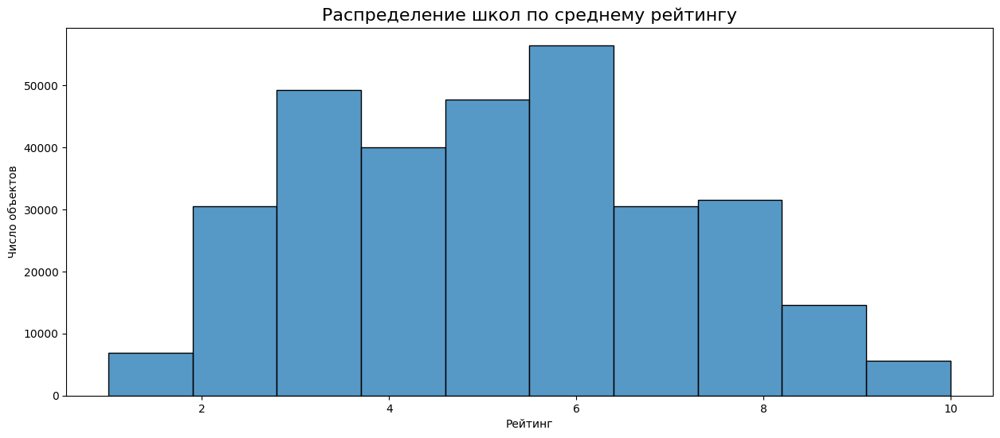

In [194]:
# Посмотрим на гистограмму распределения
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(15, 6))
plt.subplots_adjust(hspace=.0)

histplot1 = sns.histplot(
    data=data, 
    x='mean_school_rating', 
    bins=10,
)
histplot1.set_title('Распределение школ по среднему рейтингу', fontsize=16)
histplot1.set_xlabel('Рейтинг')
histplot1.set_ylabel('Число объектов')

Признак 'school_distance' представляет собой список из расстояний до школ. Создадим 2 новых признака 'mean_distance_to_school' - среднее расстояние до школы и количество школ на районе - 'schools_count'.

Посмотрим на содержание данных в признаке.

In [195]:
data['school_distance'].head(10)

0    [2.7 mi, 3.6 mi, 5.1 mi, 4.0 mi, 10.5 mi, 12.6...
1                             [1.65mi, 1.32mi, 1.01mi]
2                             [1.19mi, 2.06mi, 2.63mi]
3                      [1.05mi, 0.1mi, 1.05mi, 0.81mi]
4                                                   []
5                     [0.8 mi, 8.3 mi, 4.2 mi, 2.0 mi]
6                             [0.7 mi, 0.4 mi, 2.2 mi]
7     [5.6 mi, 5.6 mi, 6.8 mi, 6.5 mi, 6.8 mi, 6.8 mi]
8                             [0.7 mi, 0.6 mi, 1.9 mi]
9                              [0.3mi, 1.88mi, 2.37mi]
Name: school_distance, dtype: object

In [196]:
def distance_handler(df):
    """ Обработчик признака distance

    Args:
        df (Serise): необработанный признак

    Returns:
        list: обработанные признаки - средняя дистанция и количество школ
    """
    temp_list = []
    
    for item in df:
        i = item.split('mi')[0]
        temp_list.append(float(i))
    dist_mean = round(np.mean(temp_list), 2)
    schools_count = len(temp_list)
    return [dist_mean, schools_count]

In [197]:
# создаем новый признак 'mean_distance_to_school' и применяем функцию distance_handler
data['mean_school_distance'] = data['school_distance'].apply(lambda x: distance_handler(x)[0])
# создаем новый признак 'schools_count' и также применяем функцию distance_handler
data['schools_count'] = data['school_distance'].apply(lambda x: distance_handler(x)[1])


In [198]:
data['mean_school_distance'].value_counts()

mean_school_distance
0.90     3029
1.00     2916
1.10     2885
1.20     2756
0.80     2601
         ... 
15.81       1
20.27       1
19.40       1
20.77       1
25.04       1
Name: count, Length: 1938, dtype: int64

In [199]:
data['schools_count'].value_counts()

schools_count
3     180723
8      33562
2      31857
5      23168
4      17555
6       7799
1       6935
7       4367
0       2575
24      1692
13      1025
63       760
12       710
10       697
11       568
15       504
9        459
14       403
22       395
65       344
49       245
16       120
61       106
21        74
17         4
19         2
Name: count, dtype: int64

In [200]:
# удалим признак 'school_distance'
data = data.drop(['school_distance'], axis=1)

Проверим пропуски в наших новых трех признаках:

In [201]:
print(data['mean_school_rating'].isnull().sum())
print(data['mean_school_distance'].isnull().sum())
print(data['schools_count'].isnull().sum())

3363
2575
0


В признаке schools_count у нас 2575 значений с нулем, переформатируем 0 в пустое значение.\
Далее целесообразно будет заменить пропуски на медианные или средние значения в зависимости от местоположения объекта, т.е. от zip-кода.

In [202]:

data['schools_count'] = data['schools_count'].apply(lambda x: np.nan if x == 0 else x)

for zip_code in data['ZIP'].value_counts().index:
    mask = data['ZIP'] == zip_code
    value = {}
    if data[mask].isnull().sum()['mean_school_rating'] > 0:
        value.update({'mean_school_rating': (data[mask]['mean_school_rating'].mean())})
    if data[mask].isnull().sum()['mean_school_distance'] > 0:
        value.update({'mean_school_distance': (data[mask]['mean_school_distance'].mean())})
    if data[mask].isnull().sum()['schools_count'] > 0:
        value.update({'schools_count': (data[mask]['schools_count'].median())})                
    if len(value) > 0:
        data[mask] = data[mask].fillna(value)
    
print(data['mean_school_rating'].isnull().sum())
print(data['mean_school_distance'].isnull().sum())
print(data['schools_count'].isnull().sum())

81
13
13


Осталось менее сотни пропущенных значений, поэтому проще их удалить

In [203]:
data = data.dropna(subset=['mean_school_rating', 'mean_school_distance', 'schools_count'])

Дополнительно округлим средний рейтинг и среднее расстояние до 1 знака после запятой, а кол-во школ до целого:

In [204]:
data['mean_school_rating'] = round(data['mean_school_rating'], 1)
data['mean_school_distance'] = round(data['mean_school_distance'], 1)
data['schools_count'] = round(data['schools_count'])

### Признак 'beds'

In [205]:
print("Количество пропусков: ", data['beds'].isnull().sum())
print("Количество уникальных значений: ", data['beds'].nunique())
data['beds'].value_counts()[:50]

Количество пропусков:  46441
Количество уникальных значений:  100


beds
3 Beds     51770
4 Beds     34525
3          31130
2 Beds     24761
4          19832
2          15860
Baths      13486
3 bd       12343
5 Beds     10674
4 bd        8001
3.0         7879
5           6182
4.0         5093
2 bd        5006
1           4490
6 Beds      3282
5 bd        2507
2.0         2335
6           1571
5.0         1285
1 bd        1025
0            972
7 Beds       883
-- bd        682
8 Beds       626
6 bd         563
1.0          399
7            368
Bath         364
             357
9 Beds       289
6.0          264
8            248
10 Beds      142
7 bd         114
12 Beds      108
8 bd          78
11 Beds       71
9             68
10            58
7.0           48
0.0           39
8.0           31
11            27
12            26
16 Beds       25
9 bd          24
13 Beds       22
10 bd         18
12 bd         18
Name: count, dtype: int64

В данных видим 46 тыс пропусков и 100 уникальных значений. Будем унифицировать значения

In [206]:
# Заполним пустые значения нулями
data['beds'] = data['beds'].fillna('0')
# Приведем все к нижнему регистру
data['beds'] = data['beds'].apply(lambda x: x.lower())

In [ ]:
data['beds'] = data['beds'] \
.str.replace(' beds','') \
.str.replace(' bd', '') \
.str.replace('.0', '') \
.str.replace('baths', '0') \
.str.replace('bath', '0') \
.str.replace('--', '0') \
.str.replace('1-2', '2') \
.str.replace(',', '')    
data['beds'] = data['beds'].apply(lambda x: '0' if x == ' ' else x)

data['beds'].value_counts()[0:50]

Теперь удалим из нашего признака beds все что связано с площадью и заменим на 0:

In [ ]:
data['beds'] = data['beds'].apply(lambda x: '0' if ((x.find('sqft') != -1) | (x.find('acr') != -1)) else x)
data['beds'].value_counts()[:60]

In [209]:
def beds_to_int(x):
    x = x.replace('1 0 2','2')
    x = x.replace('2 0 3','3')
    x = x.replace('1 0 3','3')
    if x.startswith('based'): x = '0'
    x = re.sub('[^0-9]', '', x)
    return int(x)

data['beds'] = data['beds'].apply(beds_to_int)

In [ ]:
data['beds'].value_counts()

В наших данных 62 тыс. пропусков, это почти 20%. Для каких типов домов у нас больше всего пропусков?

In [211]:
data[data['beds'] == 0]['propertyType'].value_counts(normalize=True)

propertyType
single-family    0.383464
other            0.255381
condo            0.134274
traditional      0.113713
contemporary     0.051291
multi-family     0.032318
coop             0.016215
townhouse        0.011419
mobile home      0.001925
Name: proportion, dtype: float64

А какие у этих типов домов среднее и медианное значение количества спален?

In [212]:
for i in data['propertyType'].unique().tolist():
    mask = ((data.propertyType == i) & (data['beds'] != 0))
    beds_qty_mean = data[mask]['beds'].mean()
    beds_qty_median = data[mask]['beds'].median()
    #beds_qty_mode = data[mask]['beds'].mode()[0]
    print(f'Количество спален для типа жилья {i} составляет: среднее - {beds_qty_mean:.2f}, медиана - {beds_qty_median}')

Количество спален для типа жилья single-family составляет: среднее - 3.54, медиана - 3.0
Количество спален для типа жилья townhouse составляет: среднее - 2.89, медиана - 3.0
Количество спален для типа жилья other составляет: среднее - 3.57, медиана - 3.0
Количество спален для типа жилья coop составляет: среднее - 2.29, медиана - 2.0
Количество спален для типа жилья multi-family составляет: среднее - 5.26, медиана - 5.0
Количество спален для типа жилья condo составляет: среднее - 2.28, медиана - 2.0
Количество спален для типа жилья mobile home составляет: среднее - 2.60, медиана - 3.0
Количество спален для типа жилья contemporary составляет: среднее - nan, медиана - nan
Количество спален для типа жилья traditional составляет: среднее - nan, медиана - nan


Оказывается для домов с типом contemporary и traditional нет ни одной записи с заполненным признаком количества спален. Предлагается заполнить пустые значения медианным значением в зависимости от типа дома. Но! т.к. значений, которые мы будем фантазировать довольно таки много, то добавим признак 'beds_was_null', который подскажет нашей модели что значения додуманные.

In [213]:
# создаем новый признак и заполняем его единицами, если в основном признаке у нас стоят нули (т.е. пропуски)
data['beds_was_null'] = data['beds'].apply(lambda x: 1 if x == 0 else 0)
# Проверяем сколько строк у нас помечено
data['beds_was_null'].sum()

62350

In [214]:
data['beds'] = data['beds'].apply(lambda x: np.nan if x == 0 else x)
for prop_type in data['propertyType'].value_counts().index:
    mask = data['propertyType'] == prop_type
    if (data[mask].isnull().sum()['beds'] > 0) & ((prop_type != 'contemporary') & (prop_type != 'traditional')):
        value = {'beds': round(data[mask]['beds'].median())}
        data[mask] = data[mask].fillna(value)

Оставшиеся пустые значения для типов домов contemporary и traditional заполним медианным значением всего признака.

In [215]:
value = {'beds': data['beds'].median()}
data = data.fillna(value)

Text(0, 0.5, 'Число объектов')

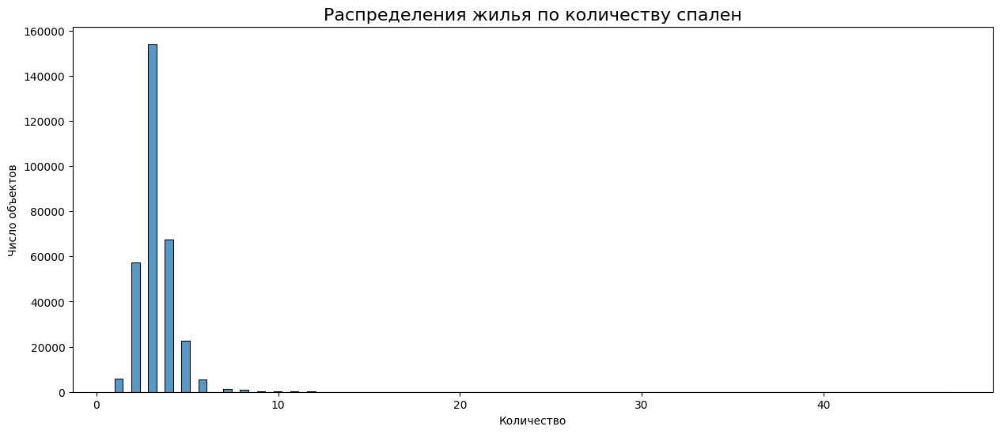

In [216]:
# Посмотрим на гистограмму распределения
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(15, 6))
plt.subplots_adjust(hspace=.0)

histplot1 = sns.histplot(
    data=data, 
    x='beds', 
    bins=100,
)
histplot1.set_title('Распределения жилья по количеству спален', fontsize=16)
histplot1.set_xlabel('Количество')
histplot1.set_ylabel('Число объектов')

### Целевой признак 'target' (2й подход)

In [217]:
print("Количество пропусков: ", data[data['target'] == 0].shape[0])
print("Количество уникальных значений: ", data['target'].nunique())

Количество пропусков:  1647
Количество уникальных значений:  31619


Столбец имеет 1647 пропусков. Выше уже попытались заполнить часть пропусков через расчет смежных признаков. Для оставшихся уже не вижу способов как избавиться, да их и не так уж и много (менее 1% от общего числа записей), поэтому предлагается избавится от этих записей.

In [218]:
data.drop(data[data['target'] == 0].index, inplace=True)
data = data.reset_index(drop=True)

In [219]:
data['target'].describe()

count    3.149210e+05
mean     5.739070e+05
std      1.084523e+06
min      1.000000e+00
25%      2.149000e+05
50%      3.359000e+05
75%      5.795000e+05
max      6.375000e+07
Name: target, dtype: float64

Как видим из описательных характеристик минимальная стоимость жилья равна 1$, что явно является выбросом. Максимальная 63 750 000$ - возможно данные некорректно внесли в базу. Медианная стоимость недвижимости равна 335 900$, при средней 573 907$. Посмотрим на распределение целевой переменной.

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 4))
histplot = sns.histplot(data=data, x='target', ax=axes[0]);
histplot.set_title('Распределение признака target');
boxplot = sns.boxplot(data=data, x='target', ax=axes[1]);
boxplot.set_title('Распределение признака target');

Из-за большого диапазона цен и выбросов мало что можно понять по графику. Cоздадим новый признак на основе целевого 'target_log' логарифмируя целевой, тем самым приведем исходное распределение к подобию нормального.

In [221]:
data['target_log'] = np.log(data['target'])

In [ ]:
fig = px.histogram(
    data_frame=data,
    x='target_log',    
    title='Распределение целевой переменной в логарифмическом масштабе',
    text_auto=True,    
    height=600,    
    width=1200, 
    nbins=100,
    marginal='box'   
)
fig.show();

Избавимся от выбросов по целевому признаку, воспользовавшись методом Тьюки, используя логарифмированный признак.

In [223]:
outliers, data = outliers_iqr(data, 'target_log', 1.5, 1.5)
print(f'Число выбросов по методу Тьюки: {outliers.shape[0]}')
print(f'Результирующее число записей: {data.shape[0]}')

Число выбросов по методу Тьюки: 14222
Результирующее число записей: 300699


Посмотрим на гистограмму и коробчатую диаграмму на новых данных.

In [224]:
fig = px.histogram(
    data_frame=data,
    x='target',    
    title='Распределение целевой переменной',
    text_auto=True,    
    height=700,    
    width=1200,
    marginal='box'     
)
fig.show()

По ассиметрии видим, что распределение имеет правый хвост. Диграмма показывает, что остались выбросы с правой стороны границы - это недвижимость стоимостью выше $1 млн. 

In [225]:
# Удаляем ненужные признаки 
data.drop(['street', 'city', 'zipcode', 'city', 'state', 'mls-id', 'MlsId'], axis = 1, inplace = True)

In [226]:
# проверим на дубликаты
data.duplicated().sum()

2872

In [227]:
# удалим дубликаты
data = data.drop_duplicates(ignore_index=True)

In [228]:
data.shape

(297827, 23)

In [229]:
# Выгрузим данные в csv для дальнейших этапов
data.to_csv('data/data_preproc.csv', index = False)

#### В результате очистки данных получен датасет с размерностью 297 827 х 23. Что составляет почти 79% от первоначального количества записей.
